In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
%matplotlib inline
import matplotlib.pyplot as plt

import sys 
import inspect
import seaborn as sns
import os

import perturbseq as perturb

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis')
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.1 umap==0.4.4 numpy==1.17.2 scipy==1.4.1 pandas==0.24.2 scikit-learn==0.22 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.8.1


In [2]:
PROTEIN='KRAS'
DATA='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14'
SUBSAMPLED=DATA+'/'+PROTEIN+'/subsampled/A549.'+PROTEIN

counts=20000

FIGS=DATA+'/2020-09-15_Figures/'
os.system('mkdir -p '+FIGS)
print(FIGS)

sc.settings.figdir=FIGS

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/2020-09-15_Figures/


In [3]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [4]:
perturb.tl.bulk(adata,grouping_variable='guide.compact')

In [5]:
import copy
sc_bulk=copy.deepcopy(adata.uns['bulk.guide.compact'].T)
sc_bulk=sc_bulk.drop(columns=['multiple'])

In [6]:
#save bulk for the clustering
res=DATA+'/'+PROTEIN+'/clustering/'+PROTEIN
os.system('mkdir -p '+DATA+'/'+PROTEIN+'/clustering/')
sc_bulk.to_csv(res+'.bulk.csv')
print(res+'.bulk.csv')

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/KRAS/clustering/KRAS.bulk.csv


In [7]:
#go to the R clustering notebook to cluster the variants
#bye!

#back!

In [9]:
#make the anno table
#add scores and cluster information
#read in the annotation file to add the clusters to it

FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.complete2.csv',sep='\t')
anno.index=anno['Variant']

anno['Position']=anno['Position'].astype('Int32')
anno['Count_pancan']=anno['Count_pancan'].astype('Int32')
anno['Count_ExAC']=anno['Count_ExAC'].astype('Int32')

#scores
ref='K169K'
score='HotellingT2'
scores=pd.read_csv(DATA+'/'+PROTEIN+'/scoring/'+PROTEIN+'.scores_vs_'+ref+'.csv')
scores.index=scores['group2']
anno[score]=scores.loc[anno.index,score]
anno['FDR.'+score]=scores.loc[anno.index,'FDR.'+score]

#cluster info
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants_df.index=sorted_variants_df[0]
anno['cluster_color']=sorted_variants_df.loc[anno.index,1]

#functional data
f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/KRAS/mutational_signatures/KRAS_mutationalSignatures_Andrew.txt'
mutsig=pd.read_csv(f,sep='\t')
mutsig.index=mutsig['Mutation']

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars

anno['Z-Low-D7']=mutsig.loc[anno.index,'Z-Low-D7']
anno['Z-Low-D14']=mutsig.loc[anno.index,'Z-Low-D14']

anno.head()



,Variant,Variant.1,Position,From,To,mutation_type,Count_pancan,Count_ExAC,control_status,control_color,Library_synthesis,long_name,control_status2,text_color,HotellingT2,FDR.HotellingT2,cluster_color,Z-Low-D7,Z-Low-D14
Variant,,,,,,,,,,,,,,,,,,,
G12D,G12D,G12D,12,C,T,Single,1782,NaN,unknown,white,in,KRAS_G12D,hotspot,red,6675.185293,0.004016,red,7.30,6.41
G12V,G12V,G12V,12,C,A,Single,1539,NaN,unknown,white,in,KRAS_G12V,hotspot,red,4679.646249,0.004016,red,6.88,5.89
G12C,G12C,G12C,12,C,A,Single,1110,NaN,unknown,white,in,KRAS_G12C,hotspot,red,4750.879970,0.004016,red,5.55,4.74
G13D,G13D,G13D,13,C,T,Single,582,NaN,unknown,white,not in library,NaN,hotspot,red,NaN,NaN,NaN,5.68,4.90
G12A,G12A,G12A,12,C,G,Single,353,NaN,unknown,white,in,KRAS_G12A,hotspot,red,4642.709510,0.004016,red,3.28,2.30


In [10]:
#annotate the cluster color onto the adata
adata.obs['Cluster']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])

In [11]:
adata.obs['Cluster2']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])
adata.obs['Cluster2'][adata.obs['guide.compact']=='unassigned']='slateblue'

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


... storing 'Cluster' as categorical
... storing 'Cluster2' as categorical


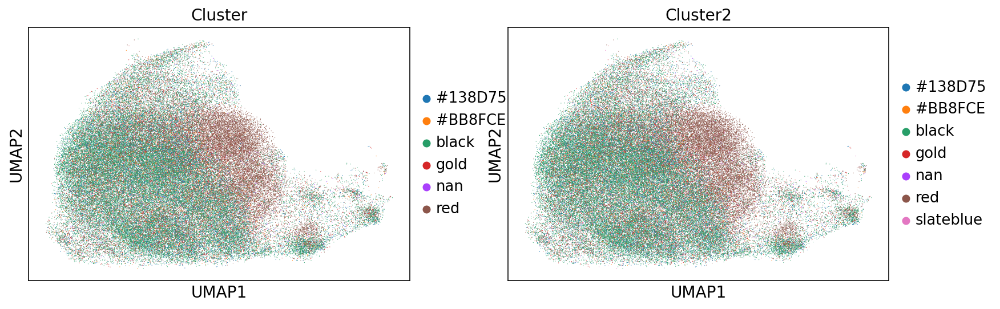

In [12]:
sc.pl.umap(adata,color=['Cluster','Cluster2'])

In [13]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

In [14]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['M111L', 'T127T', 'V112I', 'R149K', 'S17S', 'T74T', 'I163S', 'G75A', 'K147N', 'G77A', 'K88K', 'WT', 'A155G', 'Y166H', 'K176Q', 'T144T', 'C118S', 'T158T', 'A130V', 'D30D', 'K179R', 'S136N', 'T158A', 'T20T', 'D173D', 'V8V', 'A66A', 'M170L', 'K169K', 'T50T', 'R135T', 'F141L', 'R164Q', 'P110S', 'K178K', 'L159S', 'L79I', 'Q25H', 'K147T', 'E63K', 'V14I', 'T50I', 'T50P', 'E31K', 'Q99E', 'R41K', 'T20R', 'Q22H', 'C185Y', 'T20M', 'T144P', 'L52F', 'T74A', 'D57N', 'unassigned', 'N26Y', 'D33E', 'L19F', 'Q61K', 'P34L', 'K5E', 'P34R', 'G60D', 'Q61P', 'G60S', 'G60V', 'R68S', 'I36M', 'T58I', 'Q22K', 'K117R', 'A59T', 'AG59GV', 'D119G', 'G12Y', 'G12F', 'V14L', 'A59E', 'G12S', 'G12A', 'A59G', 'A146V', 'G13C', 'G12C', 'A146P', 'A146T', 'G12V', 'AG11TD', 'G12D', 'G12I', 'G12R', 'Q61A', 'Q61H', 'Q61R', 'Q61L', 'G13E', 'K117N', 'G13V', 'G13R']


In [15]:
#number of cells
#===== cells/variant
#======================

adata_full=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.analysis.h5ad')
print(adata_full)
new_mut=[]
for i in range(adata_full.n_obs):
    v=adata_full.obs['mut.std'][i]
    if v=='uninfected':
        v='unassigned'
    elif v=='H166Y':
        v='Y166H'
    else:
        v=v
    new_mut.append(v)
adata_full.obs['mut.std']=new_mut

cells_per_variant=pd.DataFrame(adata_full.obs['mut.std'].value_counts())
cells_per_variant['variant']=list(cells_per_variant.index)
print(cells_per_variant.head())



Only considering the two last: ['.analysis', '.h5ad'].
Only considering the two last: ['.analysis', '.h5ad'].
AnnData object with n_obs × n_vars = 150044 × 1145 
    obs: 'KRAS_A146P', 'KRAS_A146T', 'KRAS_A146V', 'KRAS_A59E', 'KRAS_A59G', 'KRAS_A59T', 'KRAS_AG11TD', 'KRAS_AG59GV', 'KRAS_C118S', 'KRAS_D119G', 'KRAS_D33E', 'KRAS_D57N', 'KRAS_E31K', 'KRAS_E63K-', 'KRAS_G12A', 'KRAS_G12C', 'KRAS_G12D', 'KRAS_G12F', 'KRAS_G12I', 'KRAS_G12R', 'KRAS_G12S', 'KRAS_G12V', 'KRAS_G12Y', 'KRAS_G13C', 'KRAS_G13E', 'KRAS_G13R', 'KRAS_G13V', 'KRAS_G60D', 'KRAS_G60S', 'KRAS_G60V', 'KRAS_H166Y', 'KRAS_I163S', 'KRAS_I36M', 'KRAS_K117N', 'KRAS_K117R', 'KRAS_K147N', 'KRAS_K147T', 'KRAS_K176Q', 'KRAS_K5E', 'KRAS_L159S', 'KRAS_L19F', 'KRAS_L52F', 'KRAS_L79I', 'KRAS_M111L', 'KRAS_N26Y', 'KRAS_P110S', 'KRAS_P34L', 'KRAS_P34R', 'KRAS_Q22H', 'KRAS_Q22K', 'KRAS_Q25H', 'KRAS_Q61A', 'KRAS_Q61H', 'KRAS_Q61K', 'KRAS_Q61L', 'KRAS_Q61P', 'KRAS_Q61R', 'KRAS_Q99E', 'KRAS_R135T', 'KRAS_R149K', 'KRAS_R164Q', 'KRAS_R41K', '

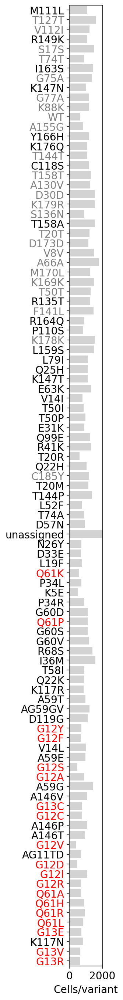

In [16]:
fig,plots=plt.subplots(1)
fig.set_size_inches(0.8,23)
plots.barh(cells_per_variant.loc[sorted_variants,'variant'].iloc[::-1],
           cells_per_variant.loc[sorted_variants,'mut.std'].iloc[::-1],
          color='lightgray')

#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
plots.set_xlim(0,2000)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]
plots.set_xlabel('Cells/variant')


plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.png',bbox_inches = "tight")
plt.show()

In [17]:
anno['Cells/variant']=cells_per_variant.loc[anno.index,'mut.std']

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [18]:
adata.obs['vbc.counts'].head()

AGAATAGCAAAGGTGCch0    0.000066
AGGGTGAAGCTCTCGGch0    0.000033
CAAGAAAAGACAAGCCch0    0.000208
CTACGTCAGTGGAGAAch0    0.000118
CTGAAGTGTAAAGGAGch0    0.000236
Name: vbc.counts, dtype: float64

In [19]:
vbc_counts=pd.DataFrame({'mut.std':adata.obs['guide.compact'],
                        'vbc_norm':10000*adata.obs['vbc.counts']})

#do DE test to find sig different ones
from scipy import stats

fdr=0.1

de_vbc=pd.DataFrame({'variant':list(set(vbc_counts['mut.std'])),
                    'p':-1,
                    'sign':1,
                    'mean_expr':-1})
for v in de_vbc['variant']:
    v_values=vbc_counts.loc[vbc_counts['mut.std']==v,'vbc_norm']
    wt_values=vbc_counts.loc[vbc_counts['mut.std']=='WT','vbc_norm']
    logratio=np.log2(np.mean(v_values)/np.mean(wt_values))
    ttest_out=stats.ttest_ind(v_values,wt_values, equal_var = False)
    p=ttest_out[1]
    de_vbc.loc[de_vbc['variant']==v,'p']=p
    de_vbc.loc[de_vbc['variant']==v,'sign']=np.sign(ttest_out[0])
    de_vbc.loc[de_vbc['variant']==v,'mean_expr']=np.mean(v_values)
    de_vbc.loc[de_vbc['variant']==v,'log2ratio_to_wt']=logratio
    
de_vbc=de_vbc.sort_values(by='p')
from statsmodels.stats.multitest import multipletests
de_vbc['p.bh']=multipletests(de_vbc['p'], alpha=0.05, method='fdr_bh')[1]
de_vbc['signed_minuslogp.bh']=-de_vbc['sign']*np.log10(de_vbc['p.bh'])
de_vbc.index=de_vbc['variant']
print(de_vbc.loc[de_vbc['p.bh']<fdr,:])
de_vbc=de_vbc.sort_values(by='signed_minuslogp.bh',ascending=True)

import copy
vbc_counts['Normalized variant\n barcode counts']=vbc_counts['vbc_norm']
vbc_counts_clip=copy.deepcopy(vbc_counts)
vbc_counts_clip['Normalized variant\n barcode counts'][vbc_counts_clip['Normalized variant\n barcode counts']>5.0]=5.0

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log2
  app.launch_new_instance()


               variant              p  sign  mean_expr  log2ratio_to_wt  \
variant                                                                   
unassigned  unassigned  8.232632e-150  -1.0   0.000000             -inf   
Q61K              Q61K   5.259161e-50  -1.0   0.682810        -0.981610   
multiple      multiple   1.423335e-46   1.0   2.264851         0.748250   
Q61L              Q61L   1.466745e-26  -1.0   0.867673        -0.635943   
T74A              T74A   3.810008e-22  -1.0   0.917723        -0.555036   
G12A              G12A   8.065837e-19   1.0   1.880001         0.479567   
K178K            K178K   1.787272e-16   1.0   1.810542         0.425255   
Q61R              Q61R   1.538130e-14  -1.0   0.989151        -0.446904   
L159S            L159S   1.783007e-13   1.0   1.752377         0.378147   
Q61A              Q61A   1.839250e-13  -1.0   1.000501        -0.430444   
T58I              T58I   3.979572e-11  -1.0   1.046082        -0.366172   
G12C              G12C   

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [20]:
var_expr_color={}
for i in range(de_vbc.shape[0]):
    col='lightgray'
    mut=de_vbc.iloc[i,0]
    pbh=de_vbc.iloc[i,1]
    direction=de_vbc.iloc[i,2]
    logratio=de_vbc['log2ratio_to_wt'][i]
    val=-np.log10(pbh)
    if np.abs(logratio)>0.5849: #1.5 fold change
        col='red'
    var_expr_color[mut]=col

In [21]:
variants=perturb.util.get_perturbations(adata,compact=True)
variants.append('unassigned')
print(variants)
constr_expr_avg=vbc_counts.groupby('mut.std').mean()
anno['variant expression']=0
anno.loc[variants,'variant_expression']=constr_expr_avg.loc[variants,
                                                                   'Normalized variant\n barcode counts']


['A130V', 'A146P', 'A146T', 'A146V', 'A155G', 'A59E', 'A59G', 'A59T', 'A66A', 'AG11TD', 'AG59GV', 'C118S', 'C185Y', 'D119G', 'D173D', 'D30D', 'D33E', 'D57N', 'E31K', 'E63K', 'F141L', 'G12A', 'G12C', 'G12D', 'G12F', 'G12I', 'G12R', 'G12S', 'G12V', 'G12Y', 'G13C', 'G13E', 'G13R', 'G13V', 'G60D', 'G60S', 'G60V', 'G75A', 'G77A', 'I163S', 'I36M', 'K117N', 'K117R', 'K147N', 'K147T', 'K169K', 'K176Q', 'K178K', 'K179R', 'K5E', 'K88K', 'L159S', 'L19F', 'L52F', 'L79I', 'M111L', 'M170L', 'N26Y', 'P110S', 'P34L', 'P34R', 'Q22H', 'Q22K', 'Q25H', 'Q61A', 'Q61H', 'Q61K', 'Q61L', 'Q61P', 'Q61R', 'Q99E', 'R135T', 'R149K', 'R164Q', 'R41K', 'R68S', 'S136N', 'S17S', 'T127T', 'T144P', 'T144T', 'T158A', 'T158T', 'T20M', 'T20R', 'T20T', 'T50I', 'T50P', 'T50T', 'T58I', 'T74A', 'T74T', 'V112I', 'V14I', 'V14L', 'V8V', 'WT', 'Y166H', 'unassigned']


In [22]:
anno['variant_expression'].describe()

count    99.000000
mean      1.344807
std       0.237248
min       0.000000
25%       1.245680
50%       1.348324
75%       1.473713
max       1.880001
Name: variant_expression, dtype: float64

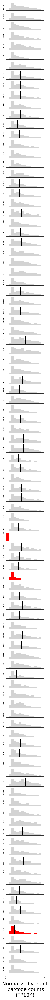

In [23]:
def plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=0.0005):
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(2,50)
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        color=var_expr_color[v]
        a=vbc_counts_clip.loc[vbc_counts_clip['mut.std']==v,'Normalized variant\n barcode counts']
        if v=='uninfected':
            a=0.0*a
        wt=vbc_counts_clip.loc[vbc_counts_clip['mut.std']=='WT','Normalized variant\n barcode counts']
        multi=5
        bins=[x/multi for x in range(int(maxi*multi))]
        #print(bins)
        outplot=sns.distplot(a, ax=ax[idx], kde=False,hist=True,
                             norm_hist=True,color=color,
                             kde_kws={"shade": False},bins=bins,
                            hist_kws=dict(alpha=1))
        ax[idx].set_xlim(mini,maxi)
        # Get the two lines from the axes to generate shading
        ###l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        ##x1 = l1.get_xydata()[:,0]
        ##y1 = l1.get_xydata()[:,1]
        ##outplot.fill_between(x1,y1, color=color, alpha=1)
        med=np.median(a)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        ax[idx].spines['right'].set_visible(False)
        ax[idx].spines['top'].set_visible(False)
        ax[idx].axvline(x=med,color='black')
        ax[idx].set_xlabel('')
        ax[idx].set_ylabel(v,fontsize=5)
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('Normalized variant\n barcode counts\n(TP10K)')
        
plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=3)
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.png',bbox_inches = "tight")

In [24]:
anno['Control']=anno['control_color']
anno['Cluster']=anno['cluster_color']
anno['Cluster2']=anno['Cluster']
anno.loc['unassigned','Cluster2']='slateblue'

In [25]:
anno.loc['unassigned','variant_expression']=0

In [26]:
anno.to_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t')

Starting point
===

In [27]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [28]:
FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t',index_col=0)


#get the threshold
def get_threshold_at_FDR(fdr_data,method,FDR=0.1,higher=True):
    fdr_passed=fdr_data.loc[fdr_data['FDR.'+method]<=FDR,:]
    if higher:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=True)
    else:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=False)
    score_thresh_value=float(list(fdr_passed[method])[0])
    return(score_thresh_value)

score='HotellingT2'
score_thresh_value=get_threshold_at_FDR(anno,score,FDR=0.01,higher=True)
print(score_thresh_value)

77.66342602192381


In [29]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['M111L', 'T127T', 'V112I', 'R149K', 'S17S', 'T74T', 'I163S', 'G75A', 'K147N', 'G77A', 'K88K', 'WT', 'A155G', 'Y166H', 'K176Q', 'T144T', 'C118S', 'T158T', 'A130V', 'D30D', 'K179R', 'S136N', 'T158A', 'T20T', 'D173D', 'V8V', 'A66A', 'M170L', 'K169K', 'T50T', 'R135T', 'F141L', 'R164Q', 'P110S', 'K178K', 'L159S', 'L79I', 'Q25H', 'K147T', 'E63K', 'V14I', 'T50I', 'T50P', 'E31K', 'Q99E', 'R41K', 'T20R', 'Q22H', 'C185Y', 'T20M', 'T144P', 'L52F', 'T74A', 'D57N', 'unassigned', 'N26Y', 'D33E', 'L19F', 'Q61K', 'P34L', 'K5E', 'P34R', 'G60D', 'Q61P', 'G60S', 'G60V', 'R68S', 'I36M', 'T58I', 'Q22K', 'K117R', 'A59T', 'AG59GV', 'D119G', 'G12Y', 'G12F', 'V14L', 'A59E', 'G12S', 'G12A', 'A59G', 'A146V', 'G13C', 'G12C', 'A146P', 'A146T', 'G12V', 'AG11TD', 'G12D', 'G12I', 'G12R', 'Q61A', 'Q61H', 'Q61R', 'Q61L', 'G13E', 'K117N', 'G13V', 'G13R']


In [30]:
import copy
def get_corr_mat(df,axis=0,corr_type='spearman'):
    
    from scipy.stats import spearmanr
    from scipy.stats import pearsonr
    
    if axis==0: #do it for rows
        df_here=np.array(copy.deepcopy(df))
    if axis==1:
        df_here=np.array(copy.deepcopy(df.T))
        
    corr_mat=np.zeros((df_here.shape[0],df_here.shape[0]))
    for i in range(df_here.shape[0]):
        #if i%10==0:
         #   display_progress(i,df_here.shape[0])
        for j in range(i,df_here.shape[0]):
            a=df_here[i,:]
            b=df_here[j,:]
            if np.std(a)==0 or np.std(b)==0:
                if corr_type in ['pearson','spearman']:
                    continue
            if corr_type=='pearson':
                val=pearsonr(a,b)[0]
            if corr_type=='spearman':
                val=spearmanr(a,b)[0]
            if corr_type=='diff':
                val=np.mean(np.abs(a-b))
            corr_mat[i,j]=val
            corr_mat[j,i]=val
    if axis==0: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.index,columns=df.index)
    if axis==1: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.columns,columns=df.columns)
    return(corr_mat)

sc_bulk=adata.uns['bulk.guide.compact']
corr_mat=get_corr_mat(sc_bulk,axis=0,corr_type='spearman')

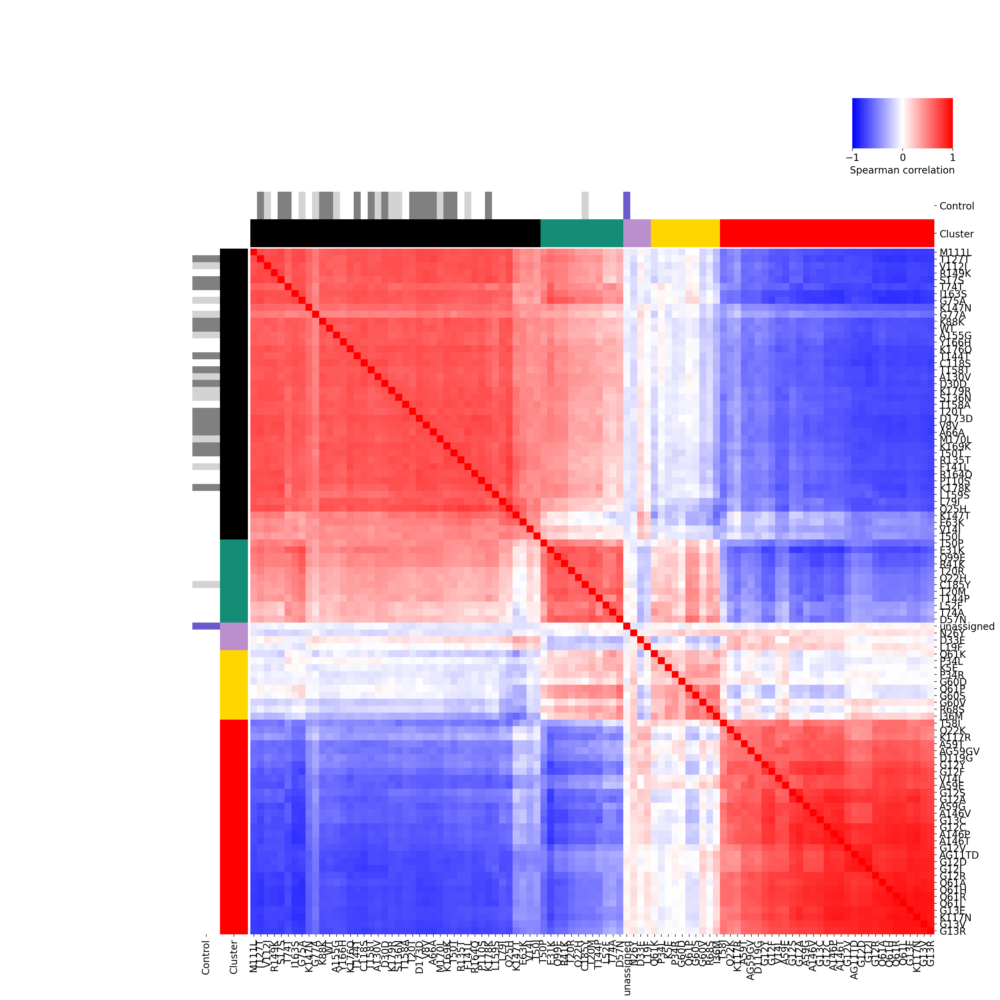

In [31]:
x=1
sns.clustermap(corr_mat.loc[sorted_variants,sorted_variants],
               cmap='bwr',vmin=-x,vmax=x,
               col_cluster=False,row_cluster=False,
              figsize=(20,20),xticklabels=True,yticklabels=True,
               cbar_pos=(0.85, 0.85, 0.1, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "Spearman correlation",
                'ticks':[-x,0,x]},
              row_colors=anno.loc[:,['Control','Cluster']],
              col_colors=anno.loc[:,['Control','Cluster']])

plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.png',bbox_inches = "tight")

Effect size
==

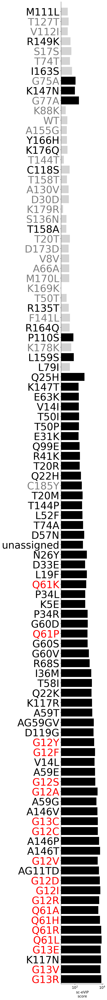

In [32]:
colors=[]
for i in sorted_variants[::-1]:
    if anno.loc[i,score]<score_thresh_value:
        colors_app='lightgray'
    else:
        colors_app='black'
    colors.append(colors_app)

fig,plots = plt.subplots(1,1)
fig.set_size_inches(3,69)
anno[score]=anno[score].astype(float)
plots.barh(sorted_variants[::-1],list(anno.loc[sorted_variants[::-1],score]),
          color=colors)
plots.set_ylim(-0.5,len(sorted_variants[::-1]))
plots.spines['top'].set_visible(False)
plots.spines['right'].set_visible(False)
plots.spines['bottom'].set_visible(True)
plots.spines['left'].set_visible(True)
plots.set_xlabel('sc-eVIP\nscore')
plots.set_xscale('log')
plots.set_yticks(sorted_variants[::-1])
plots.set_yticklabels(sorted_variants[::-1])
plots.set_yticklabels(plots.get_yticklabels(), fontsize=40)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]

plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.png',bbox_inches = "tight")

Gene programs
====

In [41]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [42]:
for pro in ['P'+str(x) for x in range(12)]:
    del adata.obs[pro]

KeyError: 'P11'

In [43]:
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


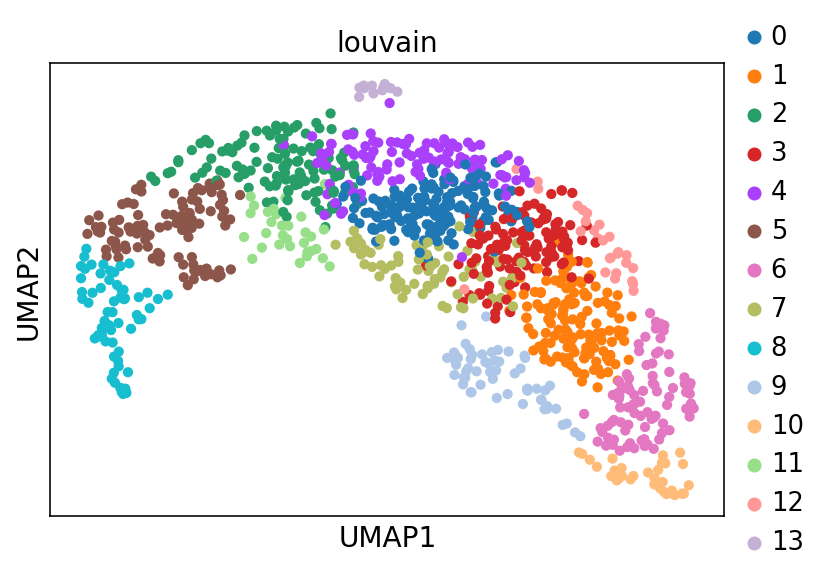

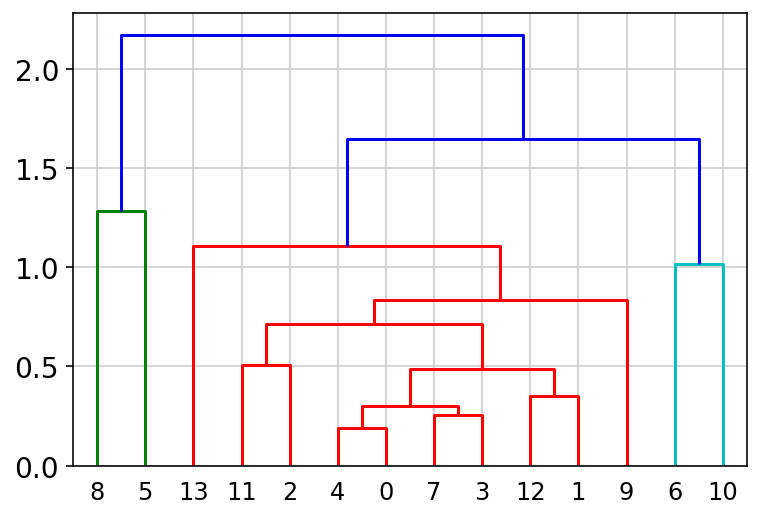

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


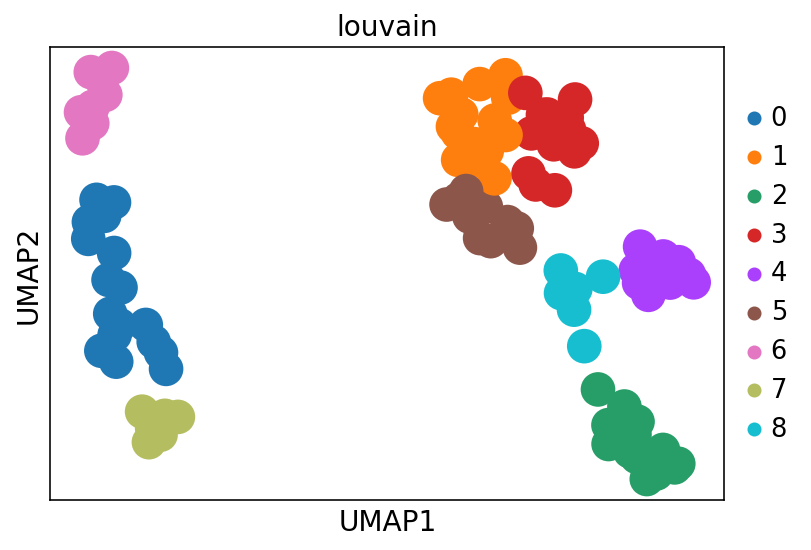

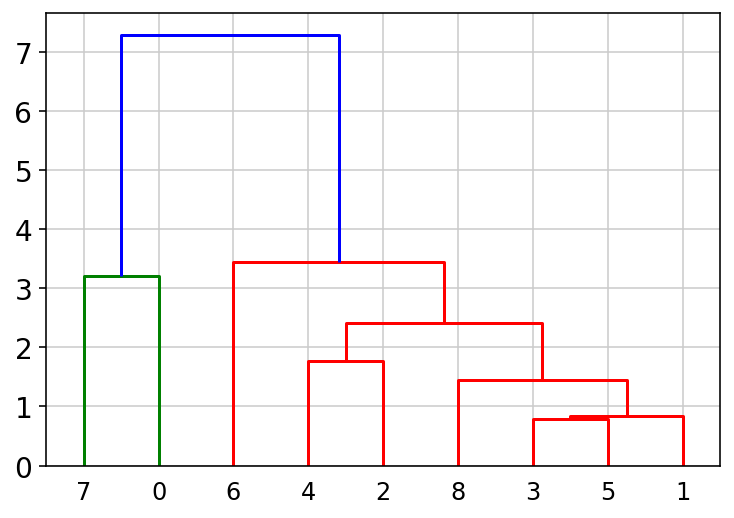

In [44]:
perturb.tl.gene_programs_and_perturbation_modules(adata,cluster_within=False,
                                                  cmap_programs='Paired')

In [45]:
sc_bulk=adata.uns['bulk.guide.compact'].T.loc[adata.var_names,sorted_variants]
sc_bulk['module']=adata.var['bulk.guide.compact.program']
sc_bulk=sc_bulk.sort_values(by='module')
sc_bulk=sc_bulk.drop(columns=['module'])

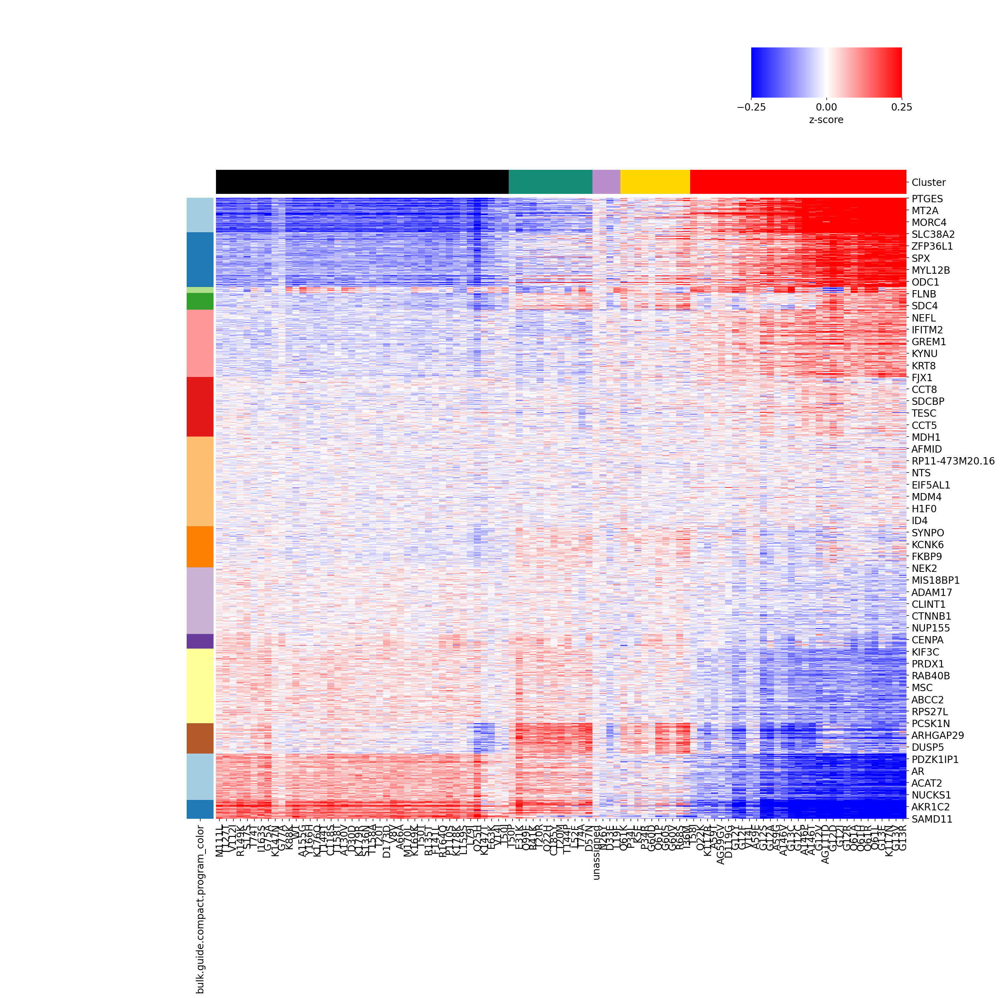

In [46]:
x=0.25
sns.clustermap(sc_bulk,
    #adata.uns['bulk.guide.compact'].T.loc[:,sorted_variants],
               row_cluster=False,col_cluster=False,
               xticklabels=True,
               figsize=(20,20),
               cbar_pos=(0.75, 0.9, 0.15, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "z-score",
                'ticks':[-x,0,x]},
               cmap='bwr',vmin=-x,vmax=x,
              row_colors=adata.var['bulk.guide.compact.program_color'],
               col_colors=anno.loc[:,'Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.regMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.regMat.png',bbox_inches = "tight")

In [47]:
def score_programs(adata_here,program_name='bulk.guide.compact.program',
                  pref=None,copy=False):
    
    if copy: adata_here = adata_here.copy()
    
    if pref is None:
        pref=program_name
    programs=list(set(adata_here.var[program_name]))
    for pro in programs:
        print('scoring',pro)
        pro_genes=adata_here.var_names[adata_here.var[program_name]==pro]
        adata.obs[pref+str(pro)]=adata[:,pro_genes].X.mean(axis=1)
        
    if copy:
        return(adata_here)
    
score_programs(adata,pref='P')

scoring 0
scoring 1
scoring 2
scoring 3
scoring 4
scoring 5
scoring 6
scoring 7
scoring 8
scoring 9
scoring 10
scoring 11
scoring 12
scoring 13


In [48]:
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [49]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

... storing 'bulk.guide.compact.program_color' as categorical


Starting point
===

In [50]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [51]:
my_programs=['P'+str(x) for x in range(14)]

In [52]:
#dotplots in all their glory
def get_bulk_programs_with_sig(adata_here,score_names,ref='unassigned',
                               variant_col='mut.std',fdr=0.1):
    
    variants=list(set(adata_here.obs[variant_col]))
    programs=score_names
    
    bulk_programs=pd.DataFrame(0,index=variants,columns=programs)
    p=pd.DataFrame(1,index=variants,columns=programs)
    
    #get scores of ref
    ref_scores={}
    for cl in programs:
        print(cl)
        if ref is None:
            ref_values=adata_here.obs[cl]
        else:
            ref_values=adata_here[adata_here.obs[variant_col]==ref,:].obs[cl]
        for variant in variants:
            variant_values=adata_here[adata_here.obs[variant_col]==variant,:].obs[cl]
            from scipy.stats import ks_2samp
            ksp=ks_2samp(ref_values,variant_values)[1]
            diff=np.mean(variant_values)-np.mean(ref_values)
            bulk_programs.loc[variant,cl]=diff
            p.loc[variant,cl]=ksp
    #will need multiple testing on the pvalues
    pval_m=p
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    p=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)

    return(bulk_programs,p)
        


In [53]:
bulk_programs_wt,p_wt=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10
P11
P12
P13


In [54]:
def dotplot_programs(bulk_programs,p,myorder,sorted_variants,
                     best_p=1e-5,fdr=0.01,vmin=-0.5,vmax=0.5,w=3,h=25):
    
    widths=[1,0.1]
    
    mlog_bestp=-np.log10(best_p)
    
    bulk_programs_long=pd.DataFrame(bulk_programs.loc[sorted_variants[::-1],myorder[::-1]].unstack())   
    p_long=pd.DataFrame(p.loc[sorted_variants,myorder[::-1]].unstack()) 
    idx=bulk_programs_long.index.to_frame()
    bulk_programs_long['variants']=idx[1]
    bulk_programs_long['cl']=idx[0]
    
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(clip=True,vmin=vmin,vmax=vmax)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.bwr)
    colors=mapper.to_rgba(bulk_programs_long[0])

    fig,plots=plt.subplots(1)
    fig.set_size_inches(w,h)
    
    mini_size=1
    stuff=plots.scatter(bulk_programs_long['cl'],bulk_programs_long['variants'],
                 c=colors,s=mini_size,cmap='bwr',vmin=vmin,vmax=vmax)
    for i in range(bulk_programs_long.shape[0]):
        v=bulk_programs_long['variants'][i]
        cl=bulk_programs_long['cl'][i]
        if p.loc[v,cl]==0.0:
            p.loc[v,cl]=best_p
        mlogp=-np.log10(p.loc[v,cl])
        if p.loc[v,cl]<=fdr:
            if mlogp>mlog_bestp:
                mlogp=mlog_bestp
            plots.scatter(bulk_programs_long['cl'][i],
                         bulk_programs_long['variants'][i],
                          color=colors[i],s=100.0*mlogp/mlog_bestp,
                          edgecolor='black',
                         linewidth=0.5,)
        else:
            plots.scatter(bulk_programs_long['cl'][i],
                         bulk_programs_long['variants'][i],
                          color=colors[i],s=max(mini_size,100.0*mlogp/mlog_bestp))
            
    plots.grid(False)
    plots.set_xticks(myorder)
    plots.set_xticklabels(myorder)
    plots.set_xticklabels(plots.get_xticklabels(), rotation=270)
    plots.set_ylim(-0.5,len(sorted_variants)-0.5)
    plots.set_xlim(-0.5,len(myorder)-0.5)

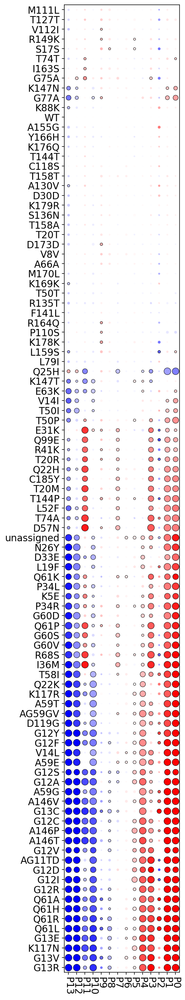

In [55]:

    

    

dotplot_programs(bulk_programs_wt,p_wt,
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-20,
                 vmin=-0.2,vmax=0.2)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.png',bbox_inches = "tight")

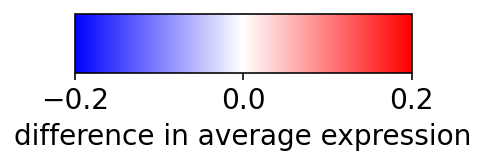

In [56]:
import matplotlib.pyplot as plt
import matplotlib as mpl

fig, ax = plt.subplots(figsize=(3, 1))
fig.subplots_adjust(bottom=0.5)

cmap = mpl.cm.bwr
norm = mpl.colors.Normalize(vmin=-0.2, vmax=0.2)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap,
                                norm=norm,
                                orientation='horizontal',ticks=[-0.2,0,0.2])
cb1.set_label('difference in average expression')
fig.show()

In [57]:
bulk_programs,p=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)


P0
P1


KeyboardInterrupt: 

In [ ]:
dotplot_programs(bulk_programs,p,
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-20,
                 vmin=-0.2,vmax=0.2)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.png',bbox_inches = "tight")

In [67]:
def ecdf_program(adata_here,score_names,grouping_variable,grouping_variable_color):
    
    n_pro=len(score_names)
    fig,plots=plt.subplots(1,n_pro)
    fig.set_size_inches(n_pro*3,2)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    c=0
    for cl_idx in range(len(score_names)):
        cl=score_names[cl_idx]
        big_number=100

        plotting_data=pd.DataFrame({'to_plot':adata_here.obs[cl],
                                       'group':adata_here.obs[grouping_variable]})

        for group in list(set(plotting_data['group'])):
            
            chosen_color=grouping_variable_color.loc[group]
            a=plotting_data.loc[plotting_data['group']==group,'to_plot']
            mini=np.quantile(plotting_data['to_plot'],0.00001)
            maxi=np.quantile(plotting_data['to_plot'],0.99)

            steps=5000
            bins=[mini+(x*1.00)/steps*(maxi-mini) for x in range(steps)]
            bins.append(big_number)
            n, bins2, patches=plots[c].hist(a,
                cumulative=True,color=chosen_color,histtype='step',density=True,bins=bins)
            plots[c].grid(False)
            plots[c].set_xlabel(cl)
            plots[c].set_title(cl)

        plots[c].set_xlim(mini,maxi)
        #plots[c].set_xticks([round(mini,2),round(maxi,2)])
        if c==0:
            plots[c].set_ylabel('ECDF')
            plots[c].set_yticks([0,1])
        else:
            plots[c].set_yticks([0,1])
        c+=1

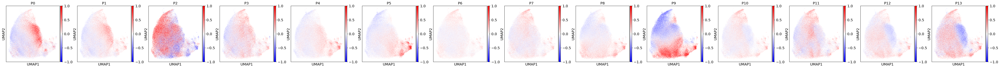

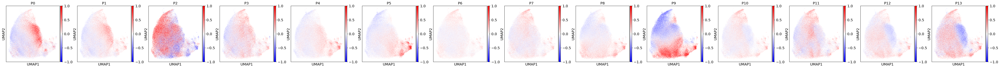

In [58]:
#plot the umaps
x=1
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save='KRAS_program_scores.pdf')
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save='KRAS_program_scores.png')

In [59]:
n=10
x=0.5
pref='P'
pro_variable='bulk.guide.compact.program'
score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']

for cl in score_names:
    genes_cl=adata.var_names[adata.var[pro_variable]==cl]
    gene_corr=pd.DataFrame({'gene':genes_cl,'corr':0},index=genes_cl)
    for gene in genes_cl:
        from scipy.stats import spearmanr,pearsonr
        c=spearmanr(sc_bulk.loc[sorted_variants,gene],
                   bulk_programs.loc[sorted_variants,pref+str(cl)])[0]
        gene_corr.loc[gene,'corr']=c
    genes_top=list(gene_corr.sort_values(by='corr',ascending=False)['corr'][:n].index)
    print(pref+str(cl),genes_top)
    
    
    print(sc_bulk.loc[sorted_variants,genes_top].T.shape)
    g=sns.clustermap(sc_bulk.loc[sorted_variants,genes_top].T,cmap='bwr',vmin=-x,vmax=x,
                  col_cluster=False,figsize=(3,3),#(3,5),#(30,5),#(3,5),
                     col_colors=anno['Cluster'],yticklabels=True,xticklabels=False)
    g.cax.set_visible(False)
    g.ax_row_dendrogram.set_visible(False)
    g.ax_col_dendrogram.set_visible(False)
    
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.png',bbox_inches = "tight")

NameError: name 'bulk_programs' is not defined

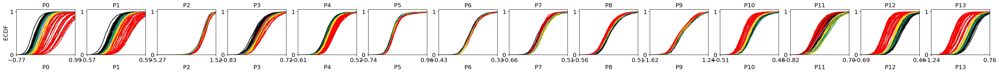

In [64]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.png',bbox_inches = "tight")
    

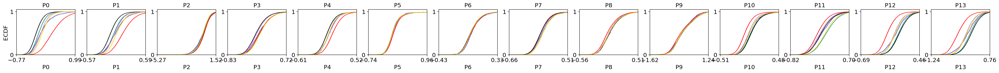

In [65]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.png',bbox_inches = "tight")


In [66]:
def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)





score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']
pro2gene={}
for cl in score_names:
    pro2gene[cl]=adata.var_names[adata.var[pro_variable]==cl]

gos=programs2go(pro2gene)

('p_value', 'Pro: 0')
name
inflammatory response               1.644907
mesodermal cell differentiation     1.644907
oncogene-induced cell senescence    1.544246
tissue development                  1.542531
gastrulation                        1.322200
Name: (p_value, Pro: 0), dtype: float64
('p_value', 'Pro: 1')
name
response to chemical                                    5.479947
response to organic substance                           5.479947
response to oxygen-containing compound                  4.913152
regulation of cell population proliferation             4.285873
cell population proliferation                           3.506816
cell communication                                      3.206180
cellular response to chemical stimulus                  3.154741
response to stimulus                                    2.968127
response to hormone                                     2.829905
programmed cell death                                   2.783560
positive regulation of cell pop

Continuum analysis
===

(with PCA)

In [119]:
for pc in range(50):
    adata.obs['PC'+str(pc)]=-adata.obsm['X_pca'][:,pc]
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [120]:
gain_pos_var=list(anno.loc[anno['Position'].isin([12,13,61]),:].index)
neutrals=list(anno.loc[anno['control_status']=='synonymous',:].index)
print(gain_pos_var)
print(neutrals)

['G12D', 'G12V', 'G12C', 'G13D', 'G12A', 'G12R', 'Q61H', 'G12S', 'G13C', 'Q61R', 'Q61L', 'Q61K', 'G12F', 'G13V', 'G13E', 'G13R', 'G12L', 'G12Y', 'Q61A', 'G12I', 'Q61P']
['V8V', 'S17S', 'T20T', 'D30D', 'T50T', 'A66A', 'Q70Q', 'T74T', 'K88K', 'T127T', 'T144T', 'T158T', 'K169K', 'D173D', 'K178K', 'WT']


... storing 'known_gain' as categorical


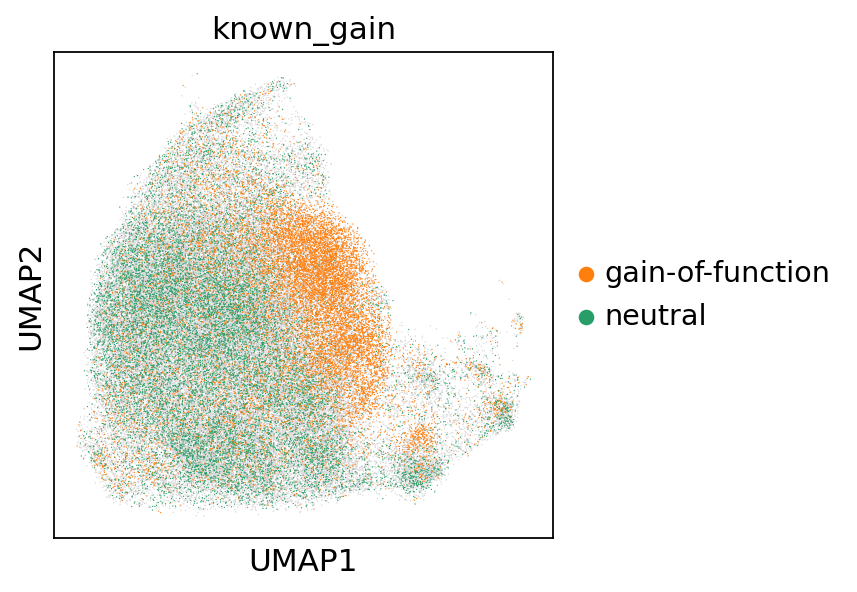

In [121]:
gain_pos=[]
for i in range(adata.n_obs):
    anno_here='NA'
    if adata.obs['guide.compact'][i] in gain_pos_var:
        anno_here='gain-of-function'
    if adata.obs['guide.compact'][i] in neutrals:
        anno_here='neutral'
    gain_pos.append(anno_here)
adata.obs['known_gain']=gain_pos

sc.pl.umap(adata,color=['known_gain'],groups=['gain-of-function','neutral'])

In [122]:
#ttest PC between known gain and the wildtypes
#genes in each PC

pc_pval=pd.DataFrame({'pc':range(50),'p':1,'t':0,'auPRC':0})
pc_pval.index=list(pc_pval['pc'])


attr='known_gain'
g1='gain-of-function'
g2='neutral'

for pc in range(50):
    if pc%10==0:
        print(pc)

    val='PC'+str(pc)
    g1_cells=adata.obs_names[adata.obs[attr]==g1]
    g2_cells=adata.obs_names[adata.obs[attr]==g2]
    g1_values=adata[g1_cells,:].obs[val]
    g2_values=adata[g2_cells,:].obs[val]

    from scipy.stats import ttest_ind
    
    res=ttest_ind(g1_values,g2_values)
    pc_pval.loc[pc,'p']=res[1]
    pc_pval.loc[pc,'t']=res[0]

0
10
20
30
40


In [123]:
from statsmodels.stats.multitest import multipletests

pc_pval['p.adj']=multipletests(pc_pval['p'],method='fdr_bh')[1]
pc_pval=pc_pval.sort_values(by='p.adj')

fdr=0.01
print(pc_pval.loc[pc_pval['p.adj']<=fdr,:].shape)
pc_pval.loc[pc_pval['p.adj']<=fdr,:]

(32, 5)


,pc,p,t,auPRC,p.adj
3,3,0.000000e+00,157.895655,0,0.000000e+00
4,4,0.000000e+00,91.268096,0,0.000000e+00
5,5,0.000000e+00,-49.114984,0,0.000000e+00
8,8,9.958969e-137,25.024259,0,1.244871e-135
14,14,1.407039e-92,20.483348,0,1.407039e-91
10,10,1.119948e-80,-19.082714,0,9.332904e-80
2,2,9.084127e-73,18.093965,0,6.488662e-72
13,13,1.551281e-72,18.064117,0,9.695505e-72
17,17,1.727868e-63,-16.862414,0,9.599268e-63
12,12,6.353827e-55,15.642206,0,3.176913e-54


View of AnnData object with n_obs × n_vars = 28526 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60

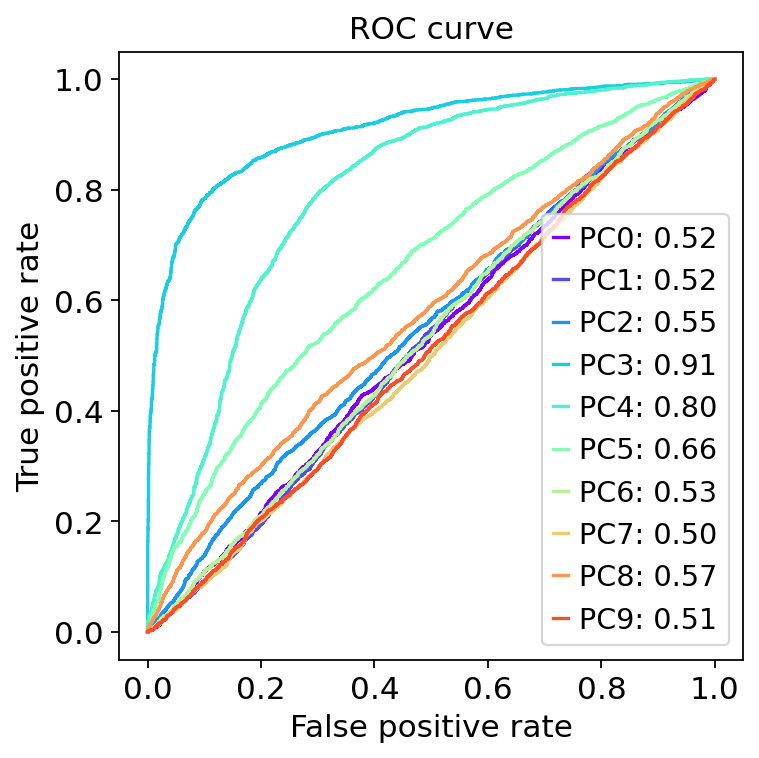

In [124]:
#classification by PCs
adata2=adata[adata.obs['known_gain'].isin(['neutral','gain-of-function']),:]
print(adata2)

adata3=perturb.pp.subsample_cells(adata2,10000,'known_gain')
print(adata3)

#X = expression
pcs=range(10)

fig,plots=plt.subplots(1)
fig.set_size_inches(5,5)

for pc in pcs:
    X=pd.DataFrame(adata3.obsm['X_pca'][:,pc],index=adata3.obs_names)

    #y=variant class
    variant_mapping={'neutral':0,'gain-of-function':1}
    y=[]
    for i in range(len(adata3.obs_names)):
        var_group=variant_mapping[adata3.obs['known_gain'][i]]
        y.append(var_group)
    classes=['neutral','gain-of-function']
   
    from sklearn.model_selection import train_test_split
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.7)
    
    from sklearn.datasets import make_gaussian_quantiles
    from sklearn.ensemble import AdaBoostClassifier
    from sklearn.metrics import accuracy_score
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.linear_model import LogisticRegression
    import numpy as np
    import matplotlib.pyplot as plt
    from sklearn import svm, datasets
    from sklearn.model_selection import train_test_split
    from sklearn.metrics import confusion_matrix
    from sklearn.utils.multiclass import unique_labels
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_curve



    clf = LogisticRegression(random_state=0, multi_class='multinomial',penalty='l2',
                            max_iter=500)
    clf.fit(X_train, y_train)

    #predict===================
    pred_valid=clf.predict(X_valid)
    pred_train=clf.predict(X_train)
    pred_valid_scores=clf.predict_proba(X_valid)[:,1]
    print(pred_valid.shape)
    
    #plot_confusion_matrix(y_valid, 
    #                  pred_valid, 
    #                  classes=classes,normalize=True,title='PC'+str(pc))
    
    print(pc,clf.score(X_valid, y_valid))
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(vmin=0, vmax=len(pcs), clip=True)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.rainbow)
    mapped_color=mapper.to_rgba(pc) #where v is the value
    fpr_rt, tpr_rt, _ = roc_curve(y_valid, pred_valid_scores)
    from sklearn import metrics
    auROC=round(metrics.auc(fpr_rt, tpr_rt),2)

    
    plots.plot(fpr_rt, tpr_rt, label='PC'+str(pc)+': '+"%.2f" % auROC,color=mapped_color)
plots.set_xlabel('False positive rate')
plots.set_ylabel('True positive rate')
plots.set_title('ROC curve')
plots.legend(loc='best')
plots.grid(False)
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.png',bbox_inches = "tight")

In [126]:
bulk_programs_pc,p_pc=get_bulk_programs_with_sig(adata,['PC'+str(x) for x in range(10)],
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


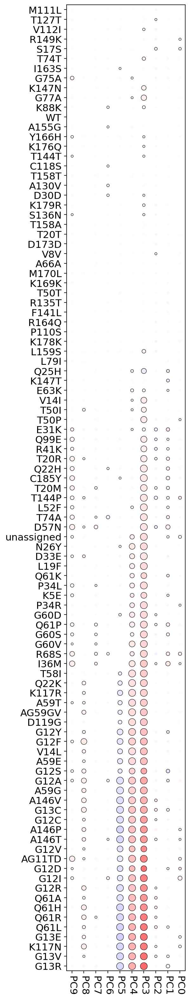

In [129]:
dotplot_programs(bulk_programs_pc,p_pc,
                 myorder=['PC'+str(x) for x in range(10)],
                 sorted_variants=sorted_variants,
                 best_p=1e-20,
                 vmin=-15,vmax=15)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.png',bbox_inches = "tight")

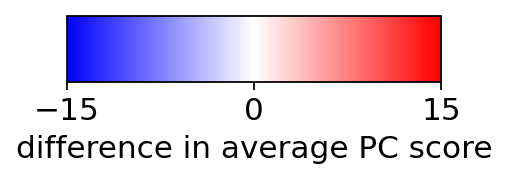

In [137]:
import matplotlib.pyplot as plt
import matplotlib as mpl

fig, ax = plt.subplots(figsize=(3, 1))
fig.subplots_adjust(bottom=0.5)

cmap = mpl.cm.bwr
norm = mpl.colors.Normalize(vmin=-15, vmax=15)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap,
                                norm=norm,
                                orientation='horizontal',ticks=[-15,0,15])
cb1.set_label('difference in average PC score')
fig.show()

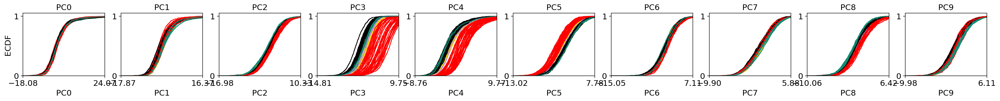

In [130]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.png',bbox_inches = "tight")

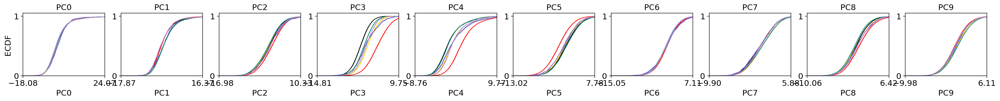

In [131]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.png',bbox_inches = "tight")

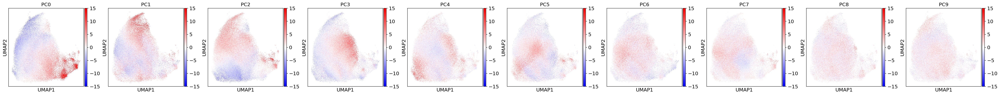

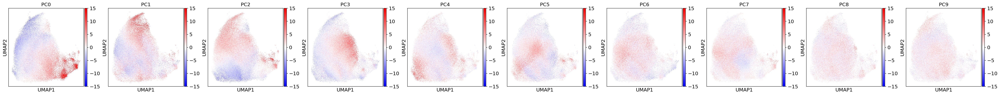

In [135]:
#plot the umaps
x=15
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save='KRAS_PC_scores.pdf')
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save='KRAS_PC_scores.png')

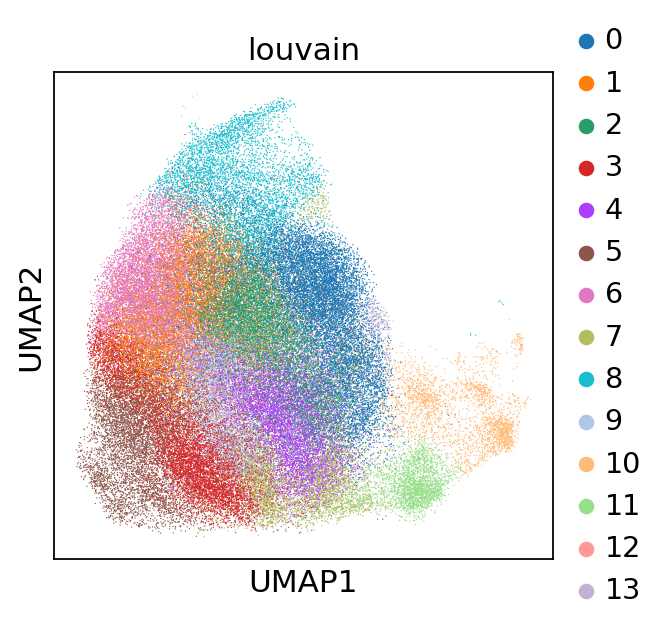

In [138]:
sc.pl.umap(adata,color=['louvain'])

In [150]:
bulk_programs_louvain_pro,p_louvain_pro=get_bulk_programs_with_sig(adata[adata.obs['guide.compact']!='multiple',:],
                                                                         ['P'+str(x) for x in range(11)],
                                           ref=None,variant_col='louvain',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10


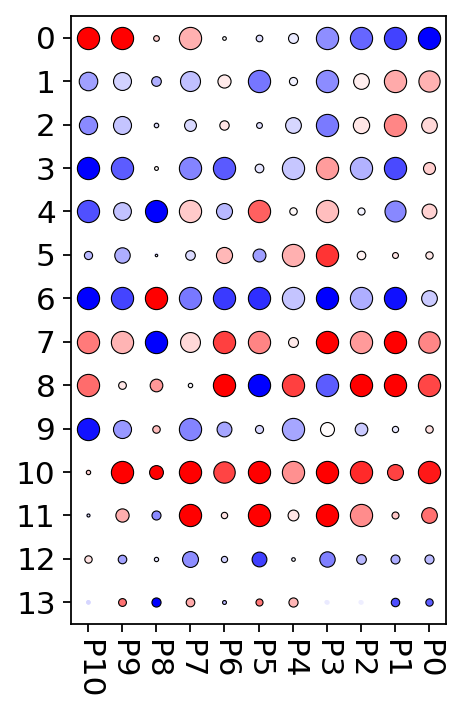

In [154]:
louvains=['0','1','2','3','4','5','6','7','8','9','10','11','12','13']
dotplot_programs(bulk_programs_louvain_pro,p_louvain_pro,
                 myorder=my_programs,
                 sorted_variants=louvains,
                 best_p=1e-200,
                 vmin=-0.2,vmax=0.2,w=3,h=5)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.png',bbox_inches = "tight")

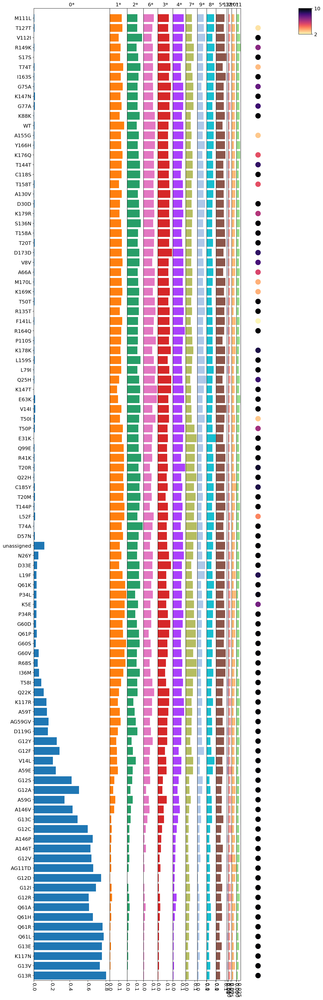

In [156]:
adata.uns['phase.multi_colors']=['gray','purple','red','orange','gold','lightblue']
def obs_split(adata_here,obs_of_interest,pref='',copy_adata=False):
    #convert one vector of obs into one obs for each encountered value 
    
    import pandas as pd
    import copy
    
    if copy_adata:
        adata_here=copy.deepcopy(adata_here)
    encountered_values=list(set(adata_here.obs[obs_of_interest]))
    cells=adata_here.obs_names
    df=pd.DataFrame(0,columns=encountered_values,index=cells)
    
    for val_idx,value in enumerate(encountered_values):
        df[value]=1.0*(adata_here.obs[obs_of_interest]==value)
    
    for col in df.columns:
        adata_here.obs[pref+col]=df[col]
    
    if copy_adata:
        return(adata_here)


def perturbation2cluster(adata_here,perturbations,cluster_variable):

    clusters=list(set(adata_here.obs[cluster_variable]))
    perturbations_found=list(set(perturbations).intersection(set(adata_here.obs.columns)))
    cluster_counts=pd.DataFrame(index=perturbations_found,columns=clusters)
    for perturbation in perturbations:
        if perturbation not in adata_here.obs.columns:
            print("WARNING: The perturbation "+perturbation+' is not saved in adata as an obs. It will not be included in this analysis.')
            continue
        perturbation_cells=adata_here[adata_here.obs[perturbation]>0,:]
        for cl in clusters:
            count=np.sum(perturbation_cells.obs[cluster_variable]==cl)
            cluster_counts.loc[perturbation,cl]=count
    return(cluster_counts)

   
def chisq_test_from_table(compositional_counts_table,reference):

    from scipy.stats import chisquare

    #compute expected fractions                                                                              
    #- either from a control perturbation or from the total                                                  
    if reference=='total':
        exp_counts=np.rint(compositional_counts_table.sum(axis=0))
    else:
        exp_counts=compositional_counts_table.loc[reference,:]
    exp_total=np.array(exp_counts).sum()
    exp_fractions=np.array(exp_counts)/np.array(exp_counts).sum()

    #go through each line of counts and perform chi-square test                                              
    chisq_stats_here=pd.DataFrame(index=compositional_counts_table.index,columns=['p','test_stat'])
    for item in compositional_counts_table.index:

        obs_counts_init=compositional_counts_table.loc[item,:]
        obs_fractions=np.array(obs_counts_init)/np.array(obs_counts_init).sum()
        obs_total=np.array(obs_counts_init).sum()
        #obs_counts=np.rint(exp_total*obs_fractions)
        obs_counts=obs_counts_init
        exp_counts=np.rint(obs_total*exp_fractions)

        test_result=chisquare(np.array(obs_counts)+1, exp_counts+1)

        chisq_stats_here.loc[item,'p']=test_result[1]
        chisq_stats_here.loc[item,'test_stat']=test_result[0]
    #adjust p-values with BH
    from statsmodels.stats.multitest import multipletests
    chisq_stats_here['p.adj']=multipletests(chisq_stats_here['p'])[1]

    chisq_stats_here=chisq_stats_here.sort_values(by='test_stat',ascending=False)
    return(chisq_stats_here)


def compositional_test(compositional_counts,reference):
    
    chisq_stats={}
    chisq_stats['perturbation']=chisq_test_from_table(compositional_counts,reference=reference)
    chisq_stats['composition']=chisq_test_from_table(compositional_counts.T,reference='total')
    sorted_compositional_counts=compositional_counts.loc[chisq_stats['perturbation'].index,
                                                         chisq_stats['composition'].index]
    chisq_stats['data']=sorted_compositional_counts
    chisq_stats['data.norm']=sorted_compositional_counts.div(sorted_compositional_counts.sum(axis=1), axis=0)
    
    return(chisq_stats)
        
def plot_compositional_test(chisq_stats,ax=None,specific_order=None,plot_kind='bar',my_colors=None,
                           FDR=0.1,ps=1e-10,multi=1):
    
    if specific_order==None:
        my_order=list(chisq_stats['data.norm'].index)
    else:
        my_order=specific_order
    compositions=list(chisq_stats['data.norm'].columns)
    
    widths=list(chisq_stats['data.norm'].max(axis=0))
    widths.append(1.0*np.sum(np.array(widths))/6)
    
    if plot_kind=='bar':
        #make the nice bar chart
        from matplotlib import gridspec

        fig = plt.figure()
        spec = gridspec.GridSpec(ncols=len(compositions)+1, nrows=1,
                         width_ratios=widths)
        
        fig.set_size_inches(1.0*(len(compositions)+1)*multi,0.5*len(my_order))

        for col_idx in range(len(compositions)):
            col=compositions[col_idx]
            if my_colors==None:
                color='black'
            else:
                color=my_colors[col_idx]
            ax = fig.add_subplot(spec[col_idx])
            
            ax.barh(my_order,chisq_stats['data.norm'].loc[my_order,col],
                               color=color,alpha=1)
            ylabel=str(col)
            if chisq_stats['composition'].loc[col,'p.adj']<=FDR:
                ylabel=ylabel+'*'
            ax.set_title(ylabel)
            ax.grid(False)
            
            if col_idx!=0:
                ax.set_yticks([])
            ax.set_ylim(-0.5,len(my_order))
            for tick in ax.get_xticklabels():
                tick.set_rotation(270) 
        ax = fig.add_subplot(spec[col_idx+1])
        
        colors=[]

        import matplotlib.cm as cm
        norm = matplotlib.colors.Normalize(vmin=0, vmax=-np.log10(ps), clip=True)
        mapper = cm.ScalarMappable(norm=norm, cmap=cm.magma_r)

        vals=[]
        sigs=[]
        for i in range(len(my_order)):
            v=-np.log10(chisq_stats['perturbation'].loc[my_order[i],'p.adj'].astype(float)+ps)
            
            v_color_vec=mapper.to_rgba(v)
            if v>=(-np.log10(FDR)):
                vals.append(v)
                sigs.append(i)

        mini=-np.log10(FDR)
        stuff=ax.scatter([1 for x in range(len(sigs))],sigs,s=200,c=vals,cmap='magma_r',
                         vmin=mini,vmax=max(vals))#c=colors)
        ax.spines['right'].set_visible(False)
        
        from mpl_toolkits.axes_grid1.inset_locator import inset_axes
        axins = inset_axes(ax,
                   width=0.5,  # width = 5% of parent_bbox width
                   height=1,  # height : 50%
                   loc='upper right',
                   bbox_to_anchor=(1.05, 0., 1, 1),
                   bbox_transform=ax.transAxes,
                   borderpad=0,
                   )
        
        fig.colorbar(stuff, cax=axins,fraction=0.5,aspect=1,ticks=[mini,max(vals)])
        ax.set_yticks([])
        ax.set_xticks([])
        ax.spines['bottom'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.set_ylim(-0.5,len(my_order))
        plt.subplots_adjust(wspace=0, hspace=0)
        
def run_compositional_test(adata_here,
                          perturbations,
                          cluster_variable,
                          reference='total',
                          specific_order=None,
                          my_colors=None,
                          FDR=0.01,
                          figsize_multi=1):
    compositional_counts=perturbation2cluster(adata_here,
                                          perturbations=perturbations,
                                          cluster_variable=cluster_variable)
    result=compositional_test(compositional_counts,reference=reference)
    
    if cluster_variable+'_colors' in adata_here.uns:
        old_color_order=adata_here.uns[cluster_variable+'_colors']
        old_color_names=list(adata_here.obs[cluster_variable].cat.categories)
        new_color_order=[]
        for i in range(result['data.norm'].shape[1]):
            cl=result['data.norm'].columns[i]
            col=old_color_order[old_color_names.index(cl)]
            new_color_order.append(col)
        my_colors=new_color_order
    plot_compositional_test(result,
                        specific_order=specific_order,
                       my_colors=my_colors,FDR=FDR,multi=figsize_multi)
    
    return(result)



louv_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='louvain',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.png',bbox_inches = "tight")

2 SpearmanrResult(correlation=-0.60143343845012, pvalue=1.453175917679776e-10)
12 SpearmanrResult(correlation=0.5139821619060023, pvalue=1.1679554115870595e-07)
0 SpearmanrResult(correlation=0.7804763507099663, pvalue=1.8046609765252184e-20)
3 SpearmanrResult(correlation=-0.5580345214008627, pvalue=5.1159643270354035e-09)
10 SpearmanrResult(correlation=-0.1822530011817752, pvalue=0.07872665781898922)
13 SpearmanrResult(correlation=0.13033675566647, pvalue=0.21053240212790844)
1 SpearmanrResult(correlation=-0.5899348671827733, pvalue=3.930722076996199e-10)
7 SpearmanrResult(correlation=-0.5797599872508102, pvalue=9.183127155815879e-10)
5 SpearmanrResult(correlation=-0.5265559297799224, pvalue=5.003183491690923e-08)
4 SpearmanrResult(correlation=-0.6135389088607006, pvalue=4.879718516319647e-11)
8 SpearmanrResult(correlation=-0.5607603583687328, pvalue=4.15210376886295e-09)
6 SpearmanrResult(correlation=-0.5686190932233347, pvalue=2.250396917785274e-09)
11 SpearmanrResult(correlation=-0.

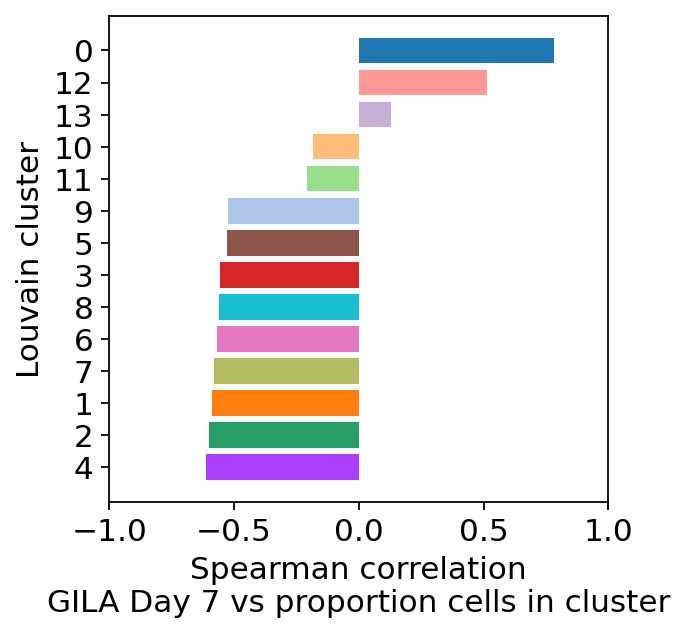

In [160]:
#corr louvain proportions with gila
#barplot with all the correlations
louvs=set(adata.obs['louvain'])
corrgila=pd.DataFrame({'corr':0},index=louvs)
for cl in louvs:
    from scipy.stats import spearmanr
    corres=spearmanr(louv_res['data.norm'].loc[sorted_variants,cl],
               anno.loc[sorted_variants,'Z-Low-D7'],nan_policy='omit')
    print(cl,corres)
    c=corres[0]
    corrgila.loc[cl,'corr']=c
 
print(corrgila)

corrgila=corrgila.sort_values(by='corr')

#cluster colors
categories=adata.obs['louvain'].cat.categories
colors=pd.DataFrame({'cl':categories,'color':adata.uns['louvain_colors']},index=categories)
print(colors)

fig,plots=plt.subplots(1)
fig.set_size_inches(4,4)
plots.barh(corrgila.index,corrgila['corr'],color=colors.loc[corrgila.index,'color'])
plots.set_xlim(-1,1)
plots.grid(False)
plots.set_xlabel('Spearman correlation\nGILA Day 7 vs proportion cells in cluster')
plots.set_ylabel('Louvain cluster')

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_gila.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_gila.png',bbox_inches = "tight")

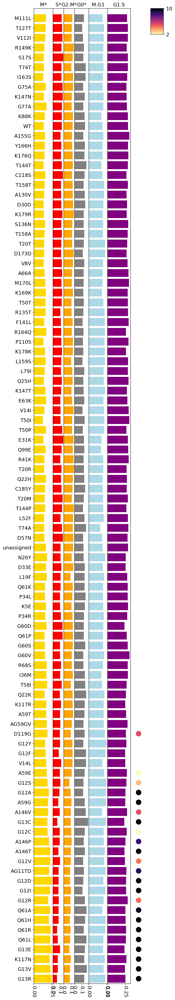

In [161]:
ccycle_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='phase.multi',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any mi

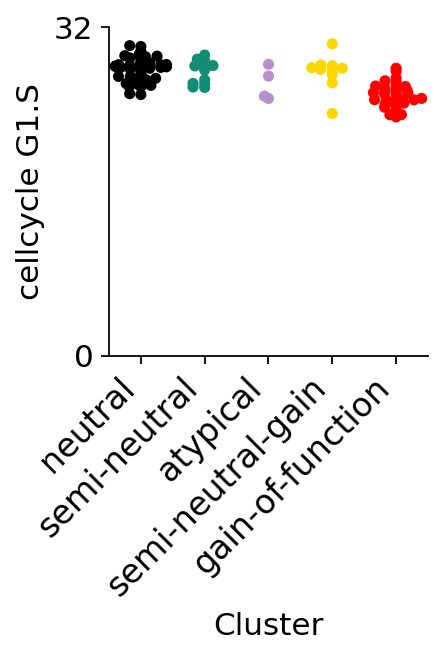

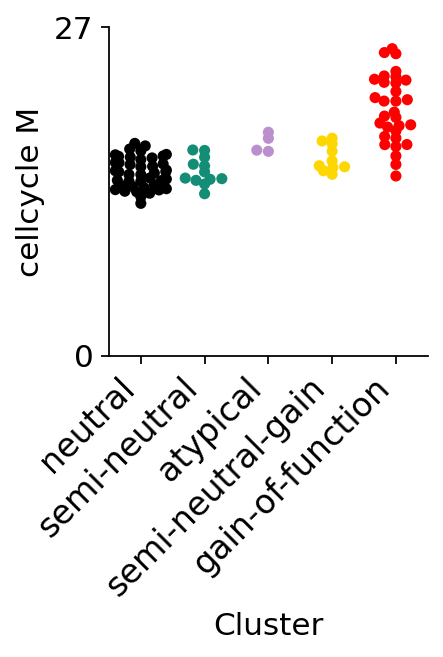

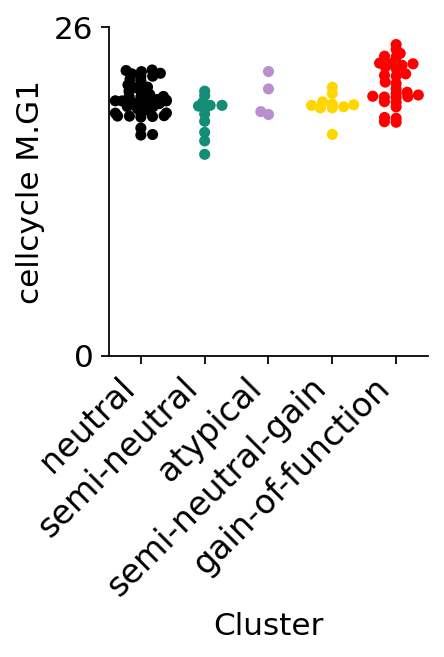

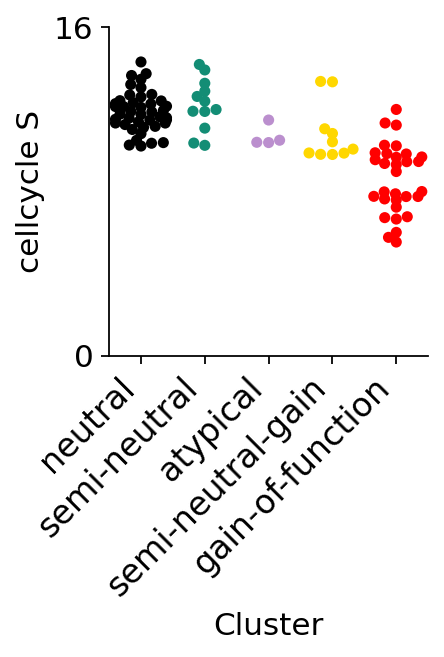

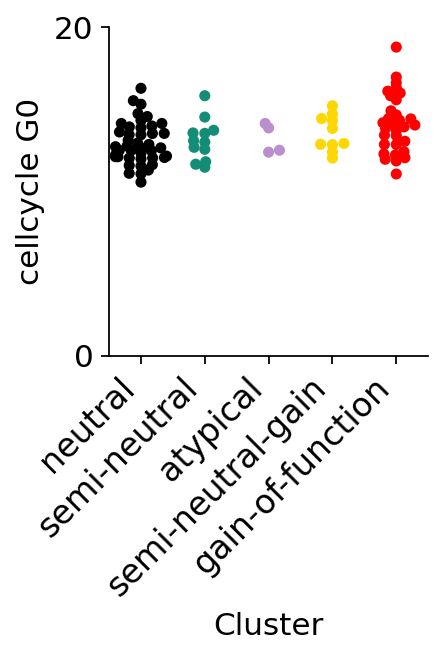

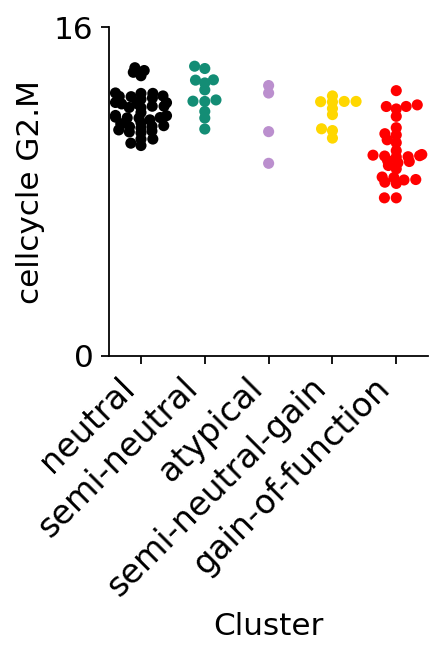

In [169]:
for cc in set(adata.obs['phase.multi']):
    anno['cellcycle '+cc]=100*ccycle_res['data.norm'].loc[anno.index,cc]

    mypal={}
    for c in set(anno['Cluster']):
        mypal[c]=c

    g =sns.catplot(x="Cluster", y='cellcycle '+cc, hue='Cluster',
                   data=anno,palette=mypal,
                  order=['black','#138D75','#BB8FCE','gold','red'],
                  height=3, # make the plot 5 units high
                    aspect=1,legend=False,kind='swarm')
    ax1 = g.axes[0,0]
    g.set(yticks=[0,int(np.max(anno['cellcycle '+cc]))+2])
    ax1.set_xticklabels(['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function'],
                        rotation=45,fontsize=15,
                       ha='right')
    plt.grid(False)

    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.png',bbox_inches = "tight") 

In [175]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

cc='M'
df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':anno.loc[sorted_variants,'cellcycle '+cc]})
condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

cc='S'
df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':anno.loc[sorted_variants,'cellcycle '+cc]})
condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

             gold         black           red   #138D75   #BB8FCE
gold     1.000000  1.564344e-02  2.874203e-04  0.062307  0.088962
black    0.015643  1.000000e+00  1.305541e-15  0.963394  0.001355
red      0.000287  1.305541e-15  1.000000e+00  0.000002  0.086878
#138D75  0.062307  9.633939e-01  1.645906e-06  1.000000  0.005173
#BB8FCE  0.088962  1.354947e-03  8.687805e-02  0.005173  1.000000
             gold         black           red       #138D75   #BB8FCE
gold     1.000000  2.143278e-02  2.080753e-03  4.141631e-02  1.000000
black    0.021433  1.000000e+00  4.497038e-15  4.398910e-01  0.041416
red      0.002081  4.497038e-15  1.000000e+00  2.205496e-07  0.041416
#138D75  0.041416  4.398910e-01  2.205496e-07  1.000000e+00  0.053954
#BB8FCE  1.000000  4.141631e-02  4.141631e-02  5.395422e-02  1.000000


Classifier
==

In [177]:
adata3=perturb.pp.subsample_cells(adata,3000,'Cluster')
adata3=adata3[adata3.obs['Cluster'].isin(['black', '#BB8FCE', 'gold', '#138D75', 'red']),:]
print(adata3)

View of AnnData object with n_obs × n_vars = 15000 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60

(array([3000.,    0., 3000.,    0.,    0., 3000.,    0., 3000.,    0.,
        3000.]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. , 2.4, 2.8, 3.2, 3.6, 4. ]),
 <a list of 10 Patch objects>)

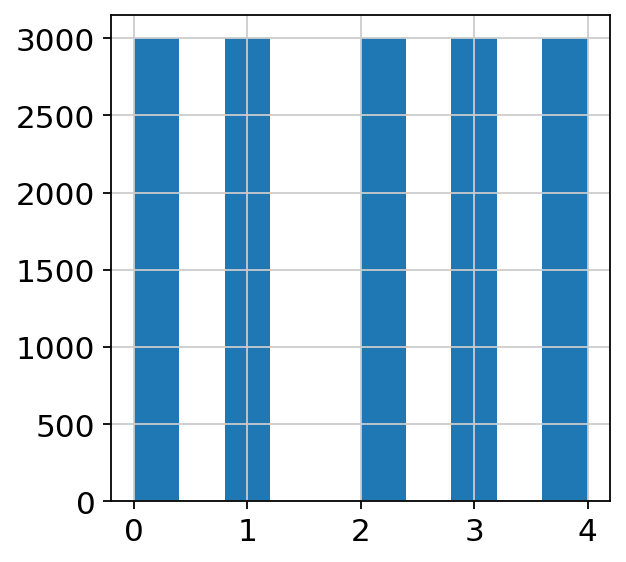

In [179]:
#X = expression
X=pd.DataFrame(adata3.X,index=adata3.obs_names,columns=adata3.var_names)

#y=variant class
variant_mapping={'black':0,'#138D75':1,'#BB8FCE':2,'gold':3,'red':4}
y=[]
for i in range(len(adata3.obs_names)):
    var_group=variant_mapping[adata3.obs['Cluster'][i]]
    y.append(var_group)
plt.hist(y)

In [180]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)

In [181]:
from sklearn.datasets import make_gaussian_quantiles
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.linear_model import LogisticRegression


clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(7500,)


Confusion matrix, without normalization
[[1134  178  134   76   18]
 [ 166  992  115  164   25]
 [ 174  137  901  164  129]
 [  92  165  180 1013   60]
 [  14   22   86   61 1300]]
Normalized confusion matrix
[[0.73636364 0.11558442 0.08701299 0.04935065 0.01168831]
 [0.11354309 0.67852257 0.07865937 0.1121751  0.01709986]
 [0.11561462 0.0910299  0.5986711  0.1089701  0.08571429]
 [0.06092715 0.10927152 0.1192053  0.67086093 0.0397351 ]
 [0.00944032 0.01483479 0.05799056 0.04113284 0.87660148]]
Confusion matrix, without normalization
[[666 356 259 123  56]
 [347 545 220 348  78]
 [311 220 417 276 271]
 [191 300 316 482 201]
 [ 48  32 281 190 966]]
Normalized confusion matrix
[[0.45616438 0.24383562 0.17739726 0.08424658 0.03835616]
 [0.22561769 0.35435631 0.14304291 0.22626788 0.05071521]
 [0.20802676 0.14715719 0.27892977 0.18461538 0.1812709 ]
 [0.12818792 0.20134228 0.21208054 0.32348993 0.13489933]
 [0.0316414  0.02109426 0.18523401 0.1252472  0.63678312]]


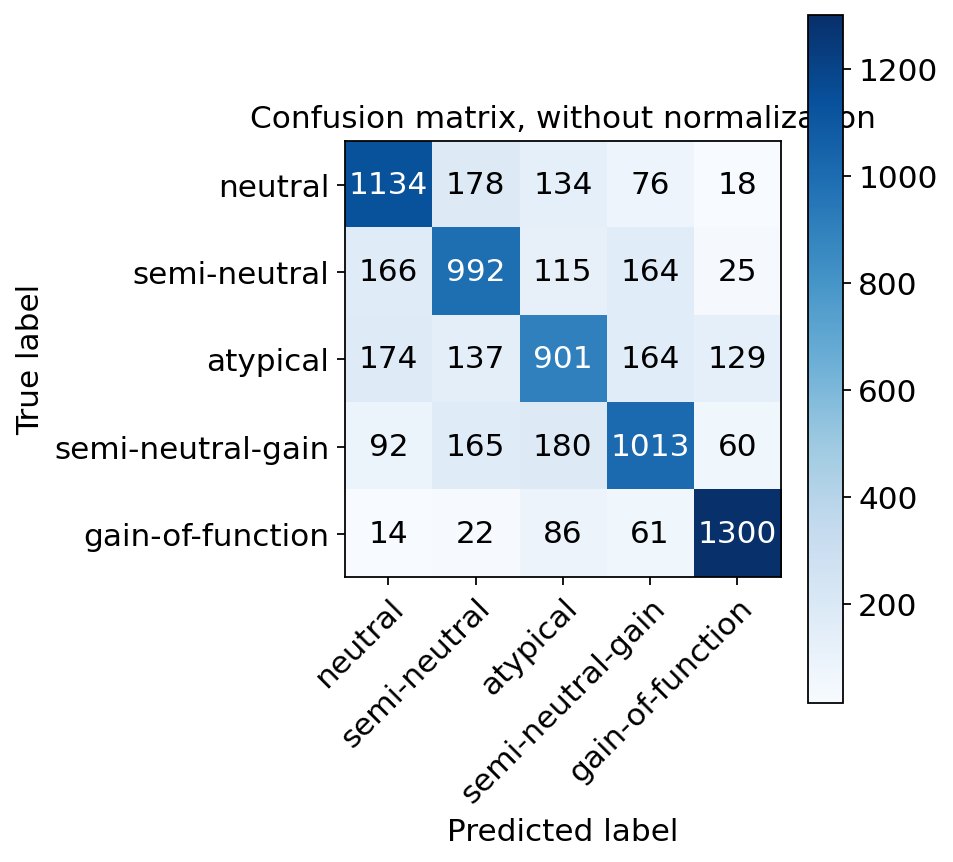

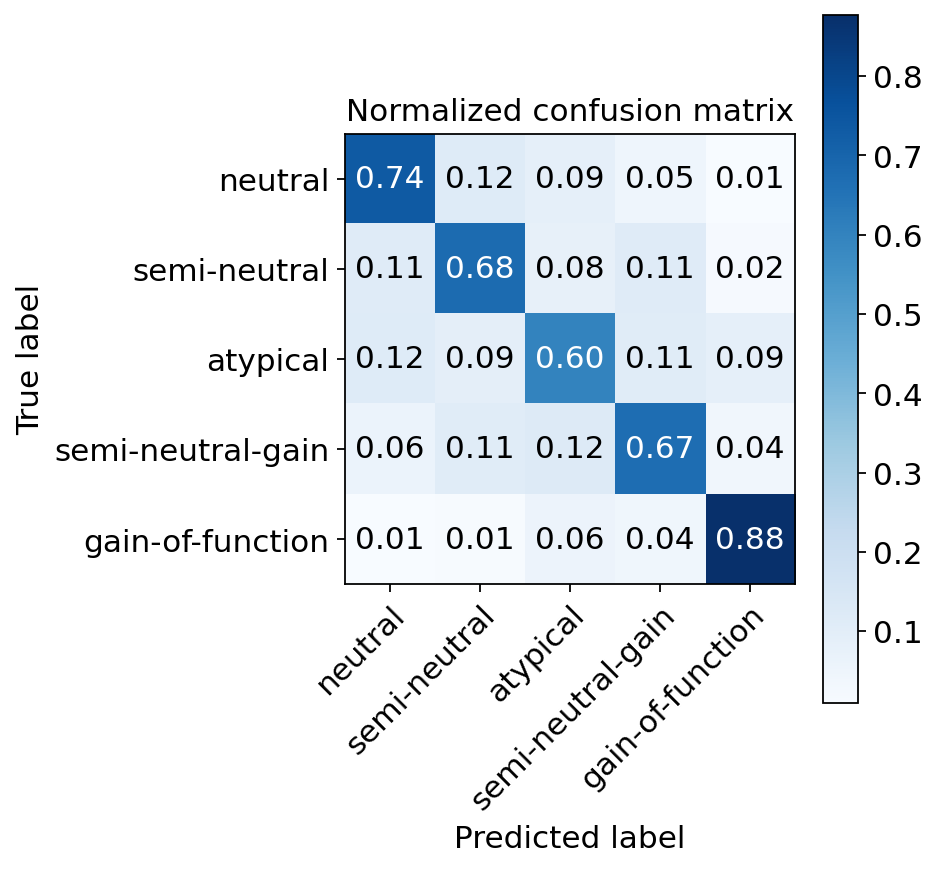

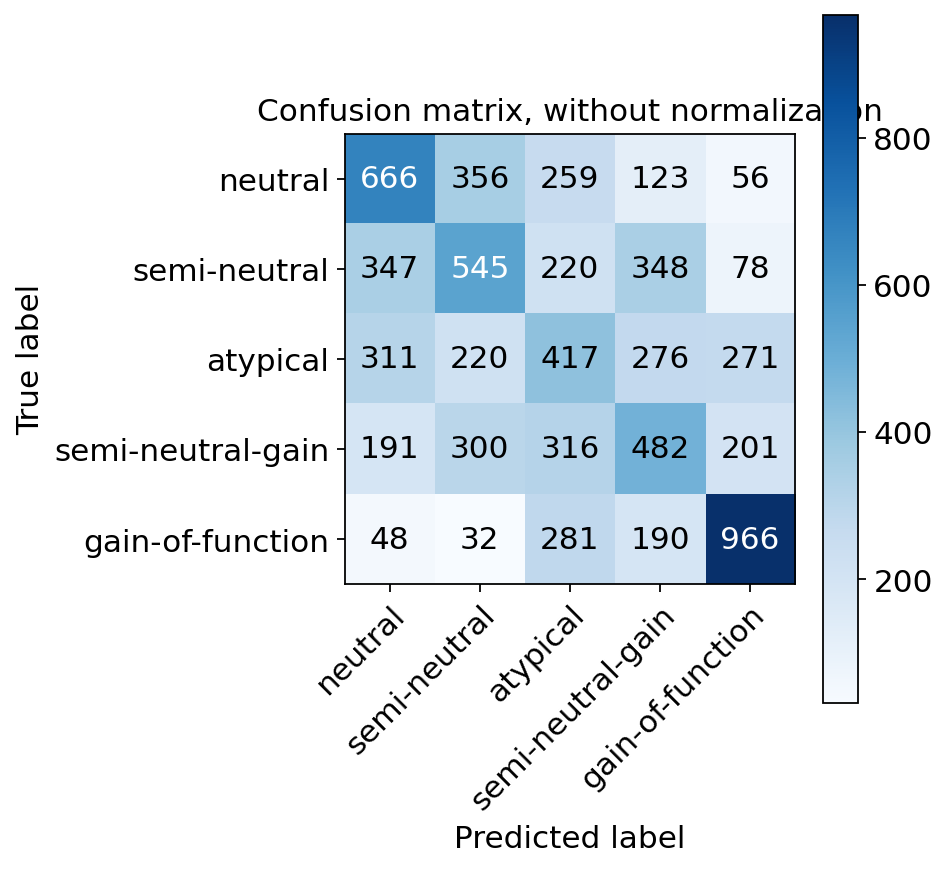

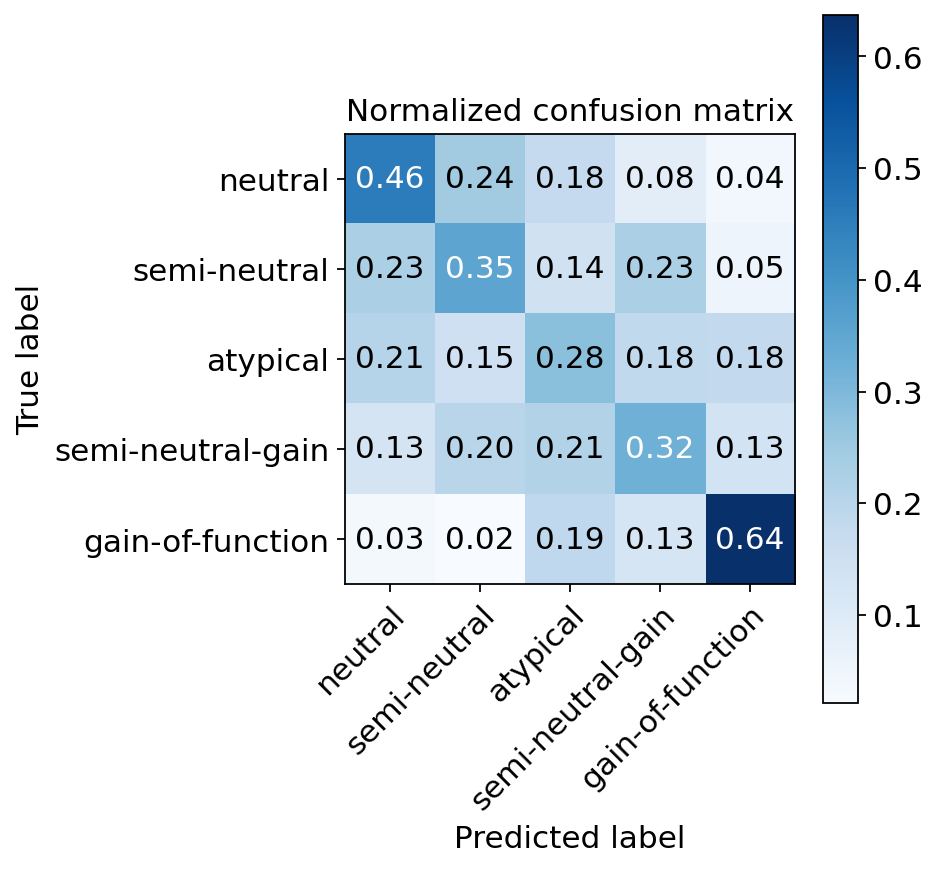

In [229]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes#classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    fig.set_size_inches(6,6)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    ax.grid(False)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

classes=['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.png',bbox_inches = "tight")

In [187]:
#look at error by louvain
errors=pd.DataFrame({'louvain':adata[X_valid.index,:].obs['louvain'],
                    'pred':pred_valid,
                    'true':y_valid})
errors['error']=errors['pred']!=errors['true']

In [204]:
error_table=pd.DataFrame(0.0,index=list(set(errors['louvain'])),
                         columns=classes)

for louv in set(errors['louvain']):
    for vclass in set(errors['true']):
        error_here=errors.loc[errors['louvain']==louv,:]
        error_here=error_here.loc[error_here['true']==vclass,'error']
        error_counts=error_here.value_counts()
        print('Louvain',louv,'class',classes[vclass],'error',error_counts[True]/error_counts.sum())
        error_table.loc[louv,classes[vclass]]=error_counts[True]/error_counts.sum()

Louvain 2 class neutral error 0.5652173913043478
Louvain 2 class semi-neutral error 0.6371681415929203
Louvain 2 class atypical error 0.7653631284916201
Louvain 2 class semi-neutral-gain error 0.6794871794871795
Louvain 2 class gain-of-function error 0.6666666666666666
Louvain 12 class neutral error 0.6875
Louvain 12 class semi-neutral error 0.75
Louvain 12 class atypical error 0.6842105263157895
Louvain 12 class semi-neutral-gain error 0.6428571428571429
Louvain 12 class gain-of-function error 0.631578947368421
Louvain 0 class neutral error 0.6666666666666666
Louvain 0 class semi-neutral error 1.0
Louvain 0 class atypical error 0.788235294117647
Louvain 0 class semi-neutral-gain error 0.6724137931034483
Louvain 0 class gain-of-function error 0.17166212534059946
Louvain 3 class neutral error 0.5077720207253886
Louvain 3 class semi-neutral error 0.6060606060606061
Louvain 3 class atypical error 0.7090909090909091
Louvain 3 class semi-neutral-gain error 0.6964285714285714
Louvain 3 class

In [205]:
error_table

,neutral,semi-neutral,atypical,semi-neutral-gain,gain-of-function
2,0.565217,0.637168,0.765363,0.679487,0.666667
12,0.687500,0.750000,0.684211,0.642857,0.631579
0,0.666667,1.000000,0.788235,0.672414,0.171662
3,0.507772,0.606061,0.709091,0.696429,0.565657
10,0.644444,0.650794,0.892857,0.722222,0.416667
13,0.875000,0.857143,0.777778,0.500000,0.333333
1,0.536723,0.684211,0.708108,0.625442,0.674419
7,0.587156,0.555556,0.807692,0.678322,0.388060
4,0.559006,0.662791,0.578947,0.675862,0.587500
5,0.538462,0.645390,0.698113,0.652482,0.488889


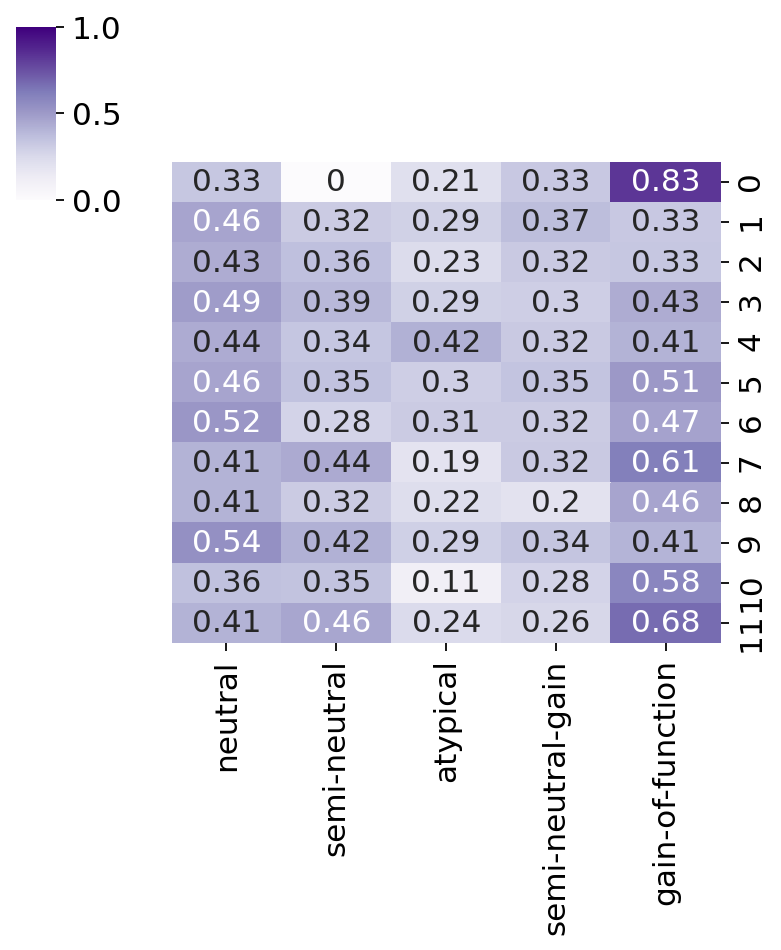

In [227]:
sns.clustermap(1-error_table.loc[['0','1','2','3','4','5','6','7','8','9','10','11'],:],
                cmap='Purples',row_cluster=False,annot=True,figsize=(5,6),
              col_cluster=False,vmin=0,vmax=1)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.png',bbox_inches = "tight")

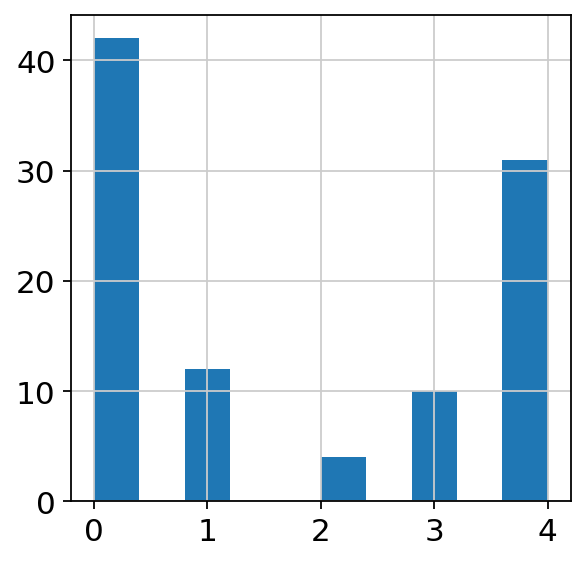

In [234]:
#now, a classifier with the bulk
X=sc_bulk

variant_mapping={'black':0,'#138D75':1,'#BB8FCE':2,'gold':3,'red':4}
keep=[]
y=[]
for i in range(len(sorted_variants)):
    variant=sorted_variants[i]
    if anno.loc[variant,'Cluster'] not in variant_mapping:
        continue
    keep.append(variant)
    var_group=variant_mapping[anno.loc[variant,'Cluster']]
    y.append(var_group)
plt.hist(y)
X=X.loc[keep,:]

In [241]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)
clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         solver='saga',
                         penalty='elasticnet',
                         l1_ratio=0.5,
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(50,)


Confusion matrix, without normalization
[[20  0  0  0  0]
 [ 0  6  0  0  0]
 [ 0  0  1  0  0]
 [ 0  0  0  6  0]
 [ 0  0  2  0 14]]
Normalized confusion matrix
[[1.    0.    0.    0.    0.   ]
 [0.    1.    0.    0.    0.   ]
 [0.    0.    1.    0.    0.   ]
 [0.    0.    0.    1.    0.   ]
 [0.    0.    0.125 0.    0.875]]
Confusion matrix, without normalization
[[22  0  0  0  0]
 [ 0  6  0  0  0]
 [ 0  0  3  0  0]
 [ 0  0  1  3  0]
 [ 0  0  1  1 13]]
Normalized confusion matrix
[[1.         0.         0.         0.         0.        ]
 [0.         1.         0.         0.         0.        ]
 [0.         0.         1.         0.         0.        ]
 [0.         0.         0.25       0.75       0.        ]
 [0.         0.         0.06666667 0.06666667 0.86666667]]


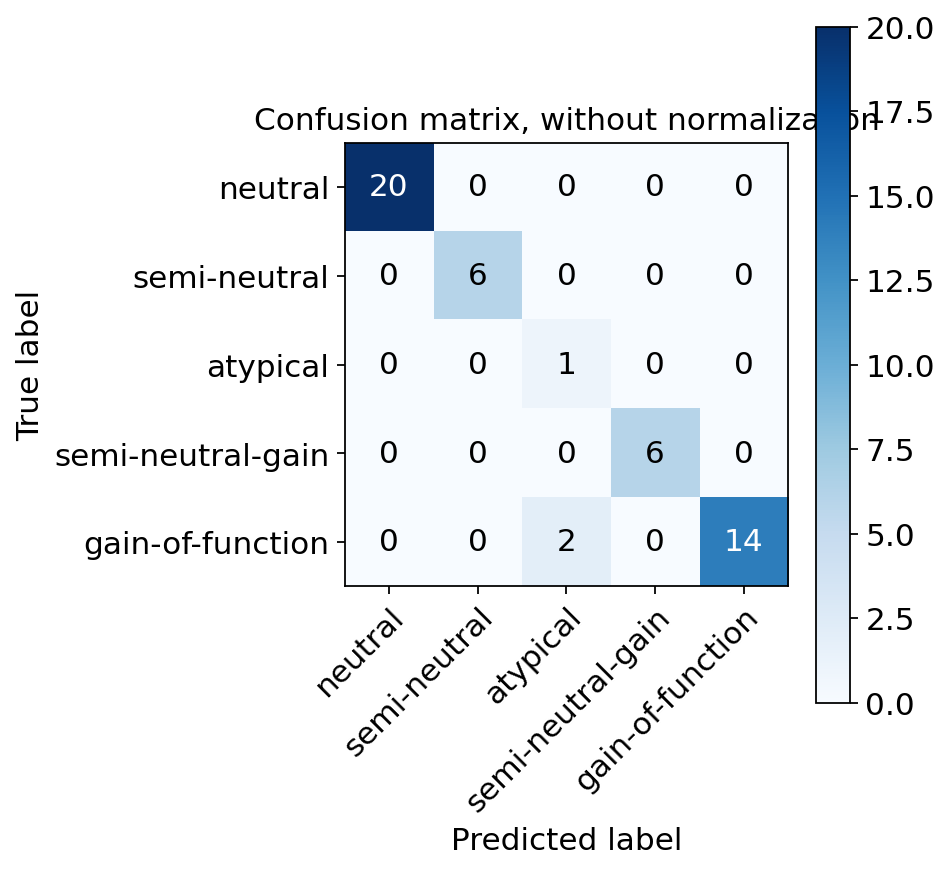

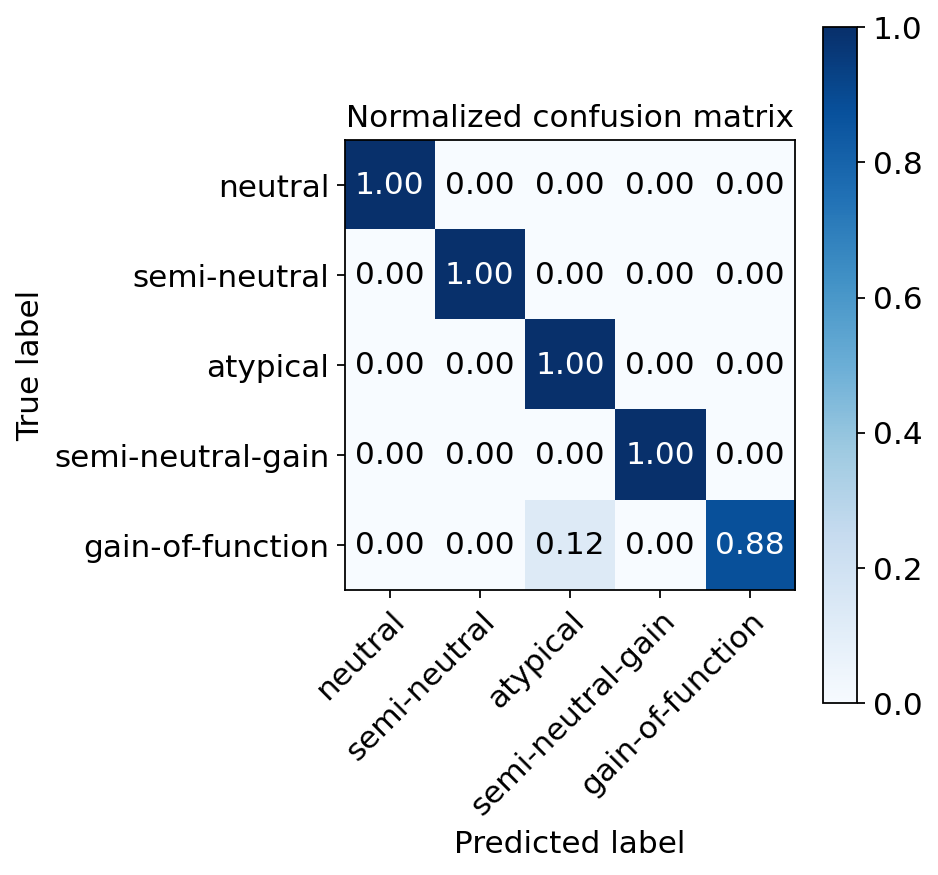

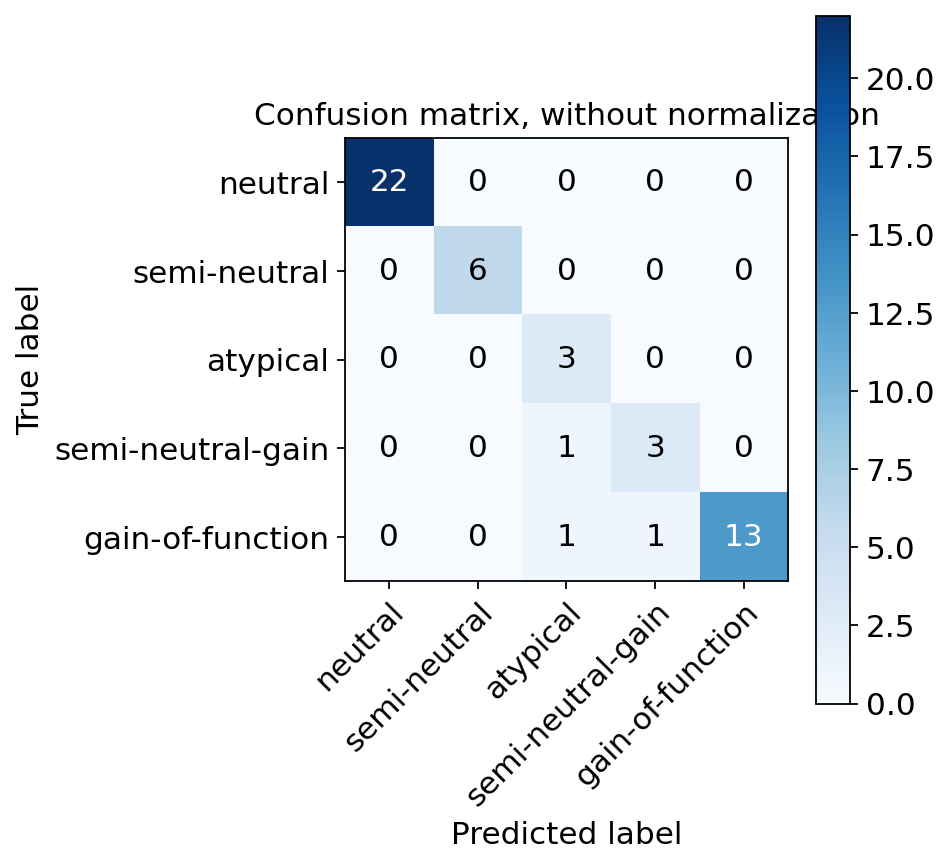

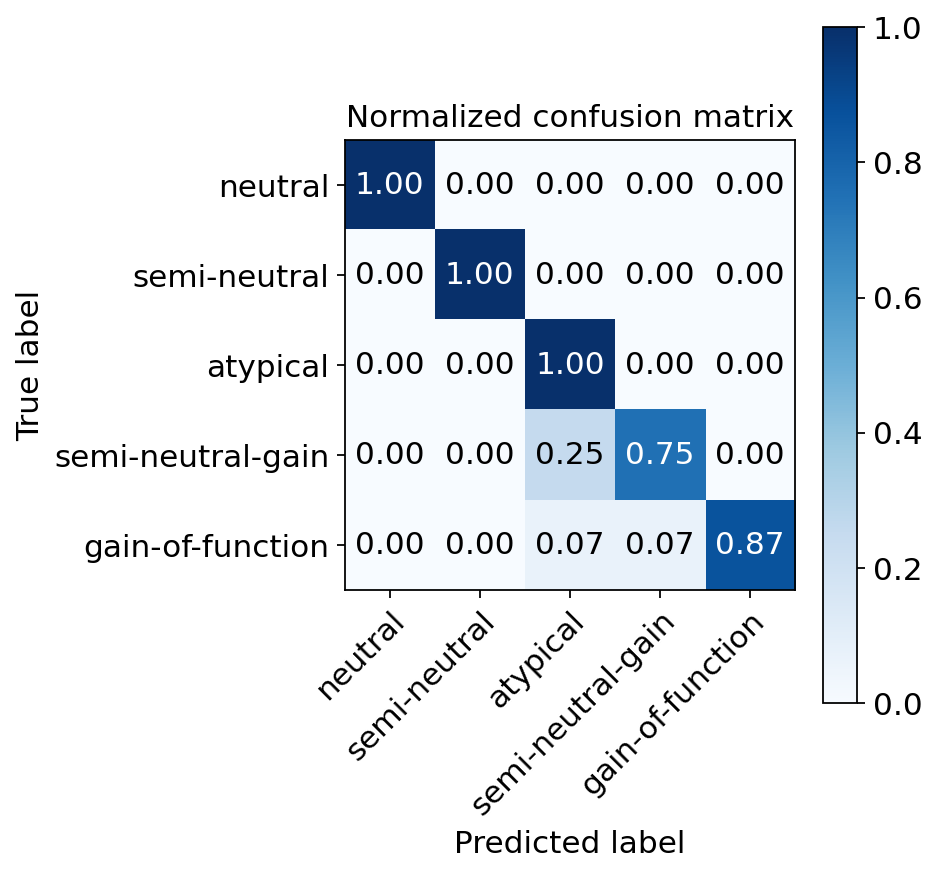

In [242]:
classes=['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.png',bbox_inches = "tight")

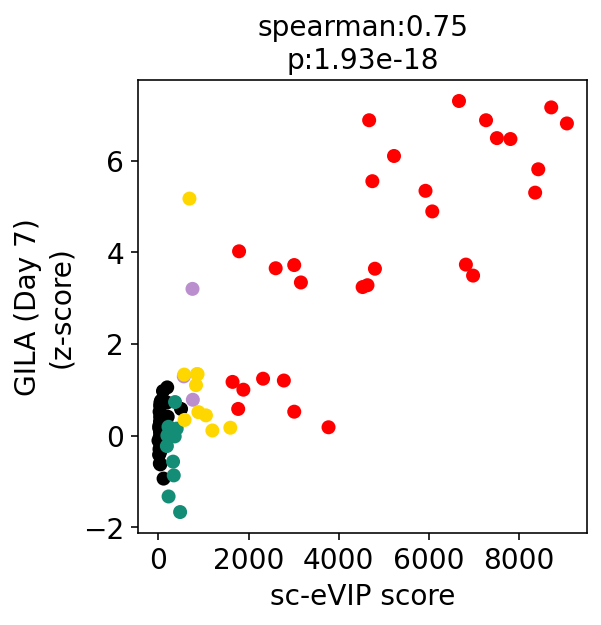

In [20]:
fun_scatter(anno.loc[sorted_variants,score],
           anno.loc[sorted_variants,'Z-Low-D7'],
           color=anno.loc[sorted_variants,'Cluster'])
plt.grid(False)
plt.xlabel('sc-eVIP score')
plt.ylabel('GILA (Day 7)\n(z-score)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'gila_vs_score.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'gila_vs_score.png',bbox_inches = "tight")

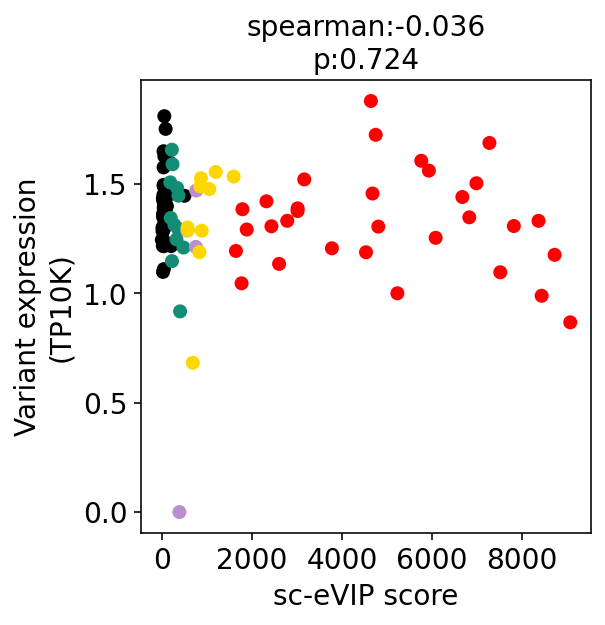

In [21]:
fun_scatter(anno.loc[sorted_variants,score],
           anno.loc[sorted_variants,'variant_expression'],
           color=anno.loc[sorted_variants,'Cluster'])
plt.grid(False)
plt.xlabel('sc-eVIP score')
plt.ylabel('Variant expression\n(TP10K)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.png',bbox_inches = "tight")

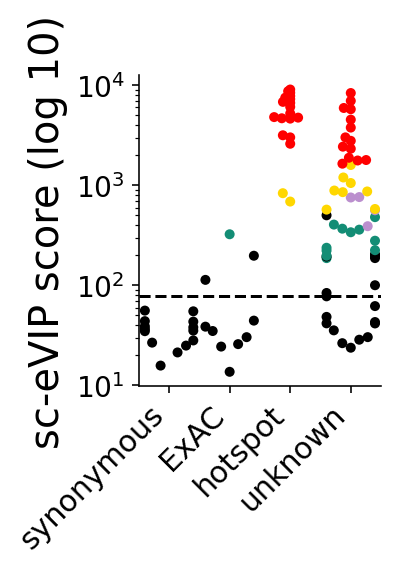

In [30]:
mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c

g =sns.catplot(x="control_status2", y=score, hue='Cluster',
               data=anno,palette=mypal,
              order=['synonymous','ExAC','hotspot','unknown'],
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)
ax1 = g.axes[0,0]
ax1.axhline(y=score_thresh_value,color='black',linestyle='--')
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('sc-eVIP score (log 10)',fontsize=20)
ax1.set_xticklabels(['synonymous','ExAC','hotspot','unknown'],rotation=45,fontsize=15,
                   ha='right')
ax1.set_yscale('log')
ax1.grid(False)
#g.set(ylim=(0,2000))
#g.set(yticks=[0.025,0.05,0.075,0.1])

plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.png',bbox_inches = "tight")

In [32]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

In [33]:
df=pd.DataFrame({'condition':anno['control_status2'],
                'value':anno[score]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

                ExAC    synonymous       unknown       hotspot
ExAC        1.000000  8.286281e-02  8.286281e-02  1.178437e-06
synonymous  0.082863  1.000000e+00  3.056084e-02  8.929788e-09
unknown     0.082863  3.056084e-02  1.000000e+00  6.174691e-10
hotspot     0.000001  8.929788e-09  6.174691e-10  1.000000e+00


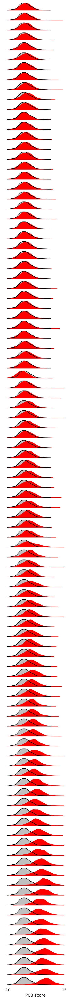

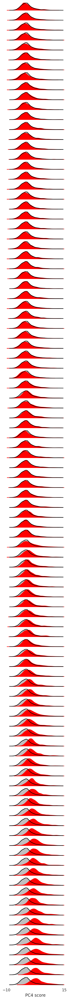

In [35]:
for PC in [3,4]:
    variants=[]
    pcs=[]
    pc_color='red'

    sns.set(rc={'axes.facecolor':'white'})
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(3,50)
    mini=-10
    maxi=15
    wt=adata[adata.obs['guide.compact']=='WT',:].obsm['X_pca'][:,PC]
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        #print(v,anno_known.loc[v,'variant_fullname'])
        a=adata[adata.obs['guide.compact']==v,:].obsm['X_pca'][:,PC]
        outplot=sns.distplot(-a, ax=ax[idx], kde=True,hist=False,color=pc_color,kde_kws={"shade": True})
        outplot=sns.distplot(-wt, ax=ax[idx], kde=True,hist=False,color='black',kde_kws={"shade": True})
        ax[idx].set_xlim(mini,maxi)
        #ax[idx].set_ylim(0,0.2)

        # Get the two lines from the axes to generate shading
        l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        x1 = l1.get_xydata()[:,0]
        y1 = l1.get_xydata()[:,1]
        outplot.fill_between(x1,y1, color=pc_color, alpha=1)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        #ax[idx].axis('off')
        ax[idx].spines['left'].set_visible(True)
        ax[idx].spines['bottom'].set_visible(True)
        ax[idx].spines['right'].set_visible(True)
        ax[idx].spines['top'].set_visible(True)
        for item_idx in range(len(a)):
            variants.append(v)
            pcs.append(a[item_idx])
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('PC'+str(PC)+' score')
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(PC)+'hist.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(PC)+'hist.png',bbox_inches = "tight")

In [ ]:
bulk_programs.head()

In [ ]:
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))

In [ ]:
for pc in range(3,5):
    x='PC'+str(pc)
    y='Z-Low-D7'
    fun_scatter(bulk_programs.loc[sorted_variants,x],
                anno.loc[sorted_variants,y],
               c=anno.loc[sorted_variants,'Cluster'])
    plt.grid(False)
    plt.xlabel(x)
    plt.ylabel('GILA')
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsGILA.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsGILA.png',bbox_inches = "tight")
    plt.show()
    
    y='variant_expression'
    fun_scatter(bulk_programs.loc[sorted_variants,x],
            anno.loc[sorted_variants,y],
           c=anno.loc[sorted_variants,'Cluster'])
    plt.grid(False)
    plt.xlabel(x)
    plt.ylabel('Variant expression')
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsExpr.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsExpr.png',bbox_inches = "tight")
    plt.show()

In [ ]:
sc.set_figure_params(figsize=(4,4),dpi=80)

for pc in range(3,5):
    sc.pl.umap(adata,color=['PC'+str(pc)],cmap='bwr',vmin=-15,vmax=15,
               save='_'+PROTEIN+'_PC'+str(pc)+'.pdf')
    sc.pl.umap(adata,color=['PC'+str(pc)],cmap='bwr',vmin=-15,vmax=15,
               save='_'+PROTEIN+'_PC'+str(pc)+'.png')

In [ ]:
pc=3
bulk_programs.loc[sorted_variants,'PC'+str(pc)].sort_values()

In [ ]:
for pc in range(3,5):
    df=pd.DataFrame({'pc':bulk_programs.loc[sorted_variants,'PC'+str(pc)],
                    'Cluster':anno.loc[sorted_variants,'Cluster']})
    mypal={}
    for i in set(df['Cluster']):
        mypal[i]=i
    g =sns.catplot(x="Cluster", y='pc', 
                  order=['black','#138D75','#BB8FCE','gold','red'],
                  height=3, 
                    aspect=1,legend=False,kind='swarm',data=df,
                  hue='Cluster',palette=mypal)

    ax1 = g.axes[0,0]
    ax1.set_xlabel('',fontsize=20)
    ax1.set_ylabel('PC'+str(pc)+' score',fontsize=20)
    ax1.set_xticklabels(['neutral','semi-neutral','atypical',
                         'semi-neutral-gain','gain-of-function'],
                        rotation=45,fontsize=15,
                       ha='right')
    ax1.grid(False)
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'means.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'means.png',bbox_inches = "tight")

In [ ]:
n_pro=2
fig,plots=plt.subplots(1,n_pro)
fig.set_size_inches(n_pro*10,8)
fig.subplots_adjust(wspace=0.2, hspace=0)

idx=0
for pro in ['PC3','PC4']:
    plots[idx].scatter(bulk_programs.loc[sorted_variants,pro],
               anno.loc[sorted_variants,'Z-Low-D7'],
                       color=anno.loc[sorted_variants,'Cluster'])
    plots[idx].set_xlabel('Mean '+pro)
    plots[idx].set_ylabel('GILA Day 7')

    for i, txt in enumerate(sorted_variants):
        plots[idx].annotate(txt, (bulk_programs.loc[sorted_variants,pro][i], 
                           anno.loc[sorted_variants,'Z-Low-D7'][i]),fontsize=7)   
    if idx!=0:
        plots[idx].set_yticks([])
    
    idx+=1

In [ ]:
FIGS

In [ ]:
anno.columns

In [ ]:
#gene analysis in the PCs
sc.set_figure_params(figsize=(4,4),dpi=200)
sc.pl.umap(adata,color=['PC3','PC4','PC5'],cmap='bwr_r')
sc.set_figure_params(figsize=(4,4),dpi=80)

In [ ]:
#now get the genes that contribute and GO them
def extract_genes_per_program(program2gene,method='zscore_on_abs_value',threshold=0,pref=''):
    
    from scipy.stats import zscore
    
    n_programs=program2gene.shape[0]
    
    program2gene_dict={}
    if method=='zscore_on_abs_value':
        #also make a nice plot with the distribution of the scores and the chosen cutoff
        program2gene_abs=np.abs(program2gene)
        program2gene_abs_z=pd.DataFrame(zscore(np.array(program2gene_abs),axis=1),
                                        index=program2gene.index,
                                        columns=program2gene.columns)
        fig,plots=plt.subplots(1,n_programs)
        fig.set_size_inches(1.5*n_programs,1)
        idx=0
        for program in list(program2gene.index):
            program2gene_dict[program]=list(program2gene_abs_z.loc[:,program2gene_abs_z.loc[program,:]>threshold].columns)
            num_genes=len(program2gene_dict[program])
            plots[idx].hist(program2gene_abs_z.loc[program,:],color='black')
            plots[idx].set_yticks([])
            plots[idx].axvline(x=threshold,color='red')
            plots[idx].grid(False)
            plots[idx].set_title(pref+str(program)+'\n'+str(num_genes)+' genes')
            idx+=1
        return(program2gene_dict)
    
def programs2go(program2gene_dict,organism="hsapiens",pref=''):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        gotable_current['program']=pref+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    return(go_table_result)

def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)

gene_prog=pd.DataFrame(adata.varm['PCs'],columns=range(50),index=adata.var_names)
program2gene_out=extract_genes_per_program(gene_prog.iloc[:,:10].T,threshold=2,pref='PC:')


In [ ]:
gos=programs2go(program2gene_out)
gos.shape

In [ ]:
gos['p_value'].sort_values(by='PC:3',ascending=False)

In [ ]:
#===== cells/variant
#======================

adata_full=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.analysis.h5ad')
print(adata_full)

new_mutstd=[]
for i in range(len(adata_full.obs_names)):
    muthere=adata_full.obs['mut.std'][i]
    if muthere=='uninfected':
        muthere='unassigned'
    new_mutstd.append(muthere)
adata_full.obs['mut.std']=new_mutstd

cells_per_variant=pd.DataFrame(adata_full.obs['mut.std'].value_counts())
cells_per_variant['variant']=list(cells_per_variant.index)
print(cells_per_variant.head())

fig,plots=plt.subplots(1)
fig.set_size_inches(0.8,20)
plots.barh(cells_per_variant.loc[sorted_variants,'variant'].iloc[::-1],
           cells_per_variant.loc[sorted_variants,'mut.std'].iloc[::-1],
          color='lightgray')
#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
plots.set_xlim(0,2000)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]
plots.grid(False)


plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.png',bbox_inches = "tight")
plt.show()

Index(['Unnamed: 0', 'Hugo_Symbol', 'Entrez_Gene_Id', 'NCBI_Build',
       'Chromosome', 'Start_position', 'End_position', 'Strand',
       'Variant_Classification', 'Variant_Type', 'Reference_Allele',
       'Tumor_Seq_Allele1', 'dbSNP_RS', 'dbSNP_Val_Status', 'Genome_Change',
       'Annotation_Transcript', 'Tumor_Sample_Barcode', 'cDNA_Change',
       'Codon_Change', 'Protein_Change', 'isDeleterious', 'isTCGAhotspot',
       'TCGAhsCnt', 'isCOSMIChotspot', 'COSMIChsCnt', 'ExAC_AF', 'CGA_WES_AC',
       'SangerWES_AC', 'SangerRecalibWES_AC', 'RNAseq_AC', 'HC_AC', 'RD_AC',
       'WGS_AC', 'Variant_annotation', 'DepMap_ID'],
      dtype='object')


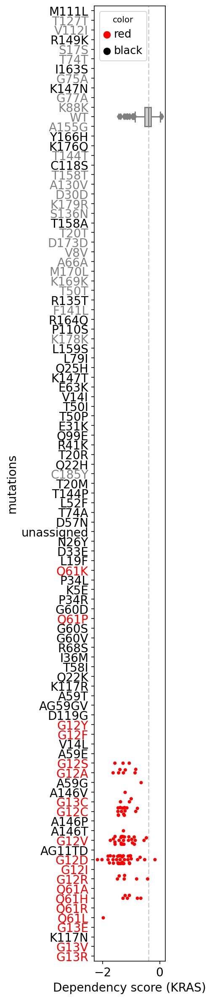

In [7]:
#depmap

import re

depdata='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/data/functional_data/dependency/2020-Q1'
dep=pd.read_csv(depdata+'/Achilles_gene_effect.csv',header=0)
dep.index=dep.iloc[:,0]

muts=pd.read_csv(depdata+'/CCLE_mutations_20Q1.csv')
muts.index=muts['DepMap_ID']
print(muts.columns)

muts=muts.loc[muts['Hugo_Symbol']=='KRAS',:]

muts['variant_name']=muts['Protein_Change']

#now, go through each cell line in dep, find its variants in muts and annotate
mut_ids=[]
for i in range(dep.shape[0]):
    cellname=dep.index[i]
    mut_set=set()
    if cellname in muts.index:
        for m in range(muts.shape[0]):
            if muts.index[m]!=cellname:
                continue
            mut=muts['variant_name'][m]
            mut_set.add(re.sub('p[.]','',mut))
    mut_id=','.join(list(mut_set))
    if len(list(mut_set))==0:
        mut_id='WT'
    mut_ids.append(mut_id)
    
dep['mutations']=mut_ids

dep['color']='black'

colors=[]
for i in range(dep.shape[0]):
    v=dep['mutations'][i]
    col_add='black'
    if v in anno.index:
        col_add=anno.loc[v,'cluster_color']
    colors.append(col_add)
dep['color']=colors 

figwidth=1.5
figheight=20
fig, ax = plt.subplots(1)
fig.set_size_inches(figwidth,figheight)

palette={'black':'black','gold':'gold','red':'red','pink':'pink','darkred':'darkred',
        'white':'pink'}
ax1 = sns.boxplot(y='mutations',x='KRAS (3845)',data=dep.loc[dep['mutations']=='WT',:],
                  order=sorted_variants,ax=ax,color='lightgray',width=2)
ax1 = sns.swarmplot(y='mutations',x='KRAS (3845)',data=dep.loc[dep['mutations']!='WT',:],
                    order=sorted_variants,ax=ax,hue=dep.loc[dep['mutations']!='WT','color'],
                    s=4,palette=palette)
ax.set_xlabel('Dependency score (KRAS)')
ax.grid(False)
ax.axvline(x=np.median(dep.loc[dep['mutations']=='WT','KRAS (3845)']),
           linestyle='--',color='lightgray')

[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants,'text_color'],ax.yaxis.get_ticklabels())]

plt.savefig(FIGS+'/KRAS.DepMap.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap.png',bbox_inches = "tight")


plt.show()


In [31]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

In [8]:



df=pd.DataFrame({'condition':dep.loc[dep['mutations'].isin(sorted_variants),'mutations']=='WT',
                'value':dep.loc[dep['mutations'].isin(sorted_variants),'KRAS (3845)'],
                'mutations':dep.loc[dep['mutations'].isin(sorted_variants),'mutations']})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

               False          True 
False   1.000000e+00  8.253844e-147
True   8.253844e-147   1.000000e+00


In [9]:
set(df['mutations'])

{'A146T',
 'A146V',
 'A59G',
 'G12A',
 'G12C',
 'G12D',
 'G12R',
 'G12S',
 'G12V',
 'G13C',
 'Q61H',
 'Q61L',
 'WT'}

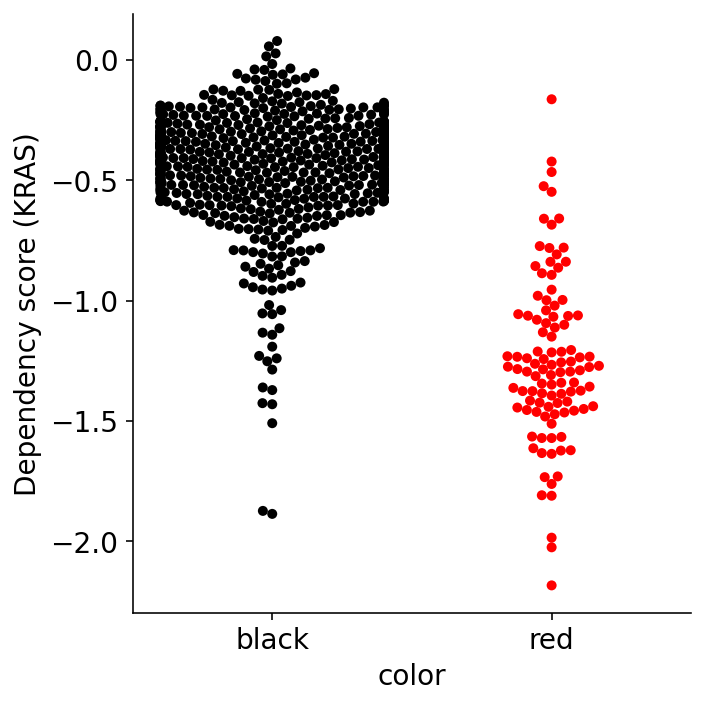

In [10]:
mypal={'black':'black','red':'red'}
sns.catplot(x='color',y='KRAS (3845)',data=dep,order=['black','red'],
           kind='swarm',palette=mypal)
plt.grid(False)
plt.ylabel('Dependency score (KRAS)')
plt.savefig(FIGS+'/KRAS.DepMap_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap_swarm.png',bbox_inches = "tight")

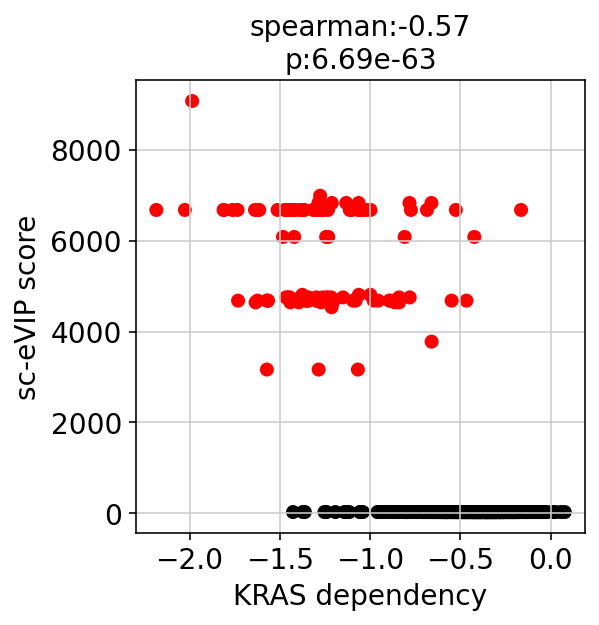

In [17]:
dep_small=dep.loc[dep['mutations'].isin(list(set(adata.obs['guide.compact']))),:]
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))
    
fun_scatter(dep_small['KRAS (3845)'],anno.loc[dep_small['mutations'],score],
           color=anno.loc[dep_small['mutations'],'Cluster'])
plt.xlabel('KRAS dependency')
plt.ylabel('sc-eVIP score')
plt.savefig(FIGS+'/KRAS.DepMap_vs_scevip.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap_vs_scevip.png',bbox_inches = "tight")

In [6]:
#mutation frequency
#functional data
f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/KRAS/mutational_signatures/KRAS_mutationalSignatures_Andrew.txt'
mutsig=pd.read_csv(f,sep='\t')
mutsig.index=mutsig['Mutation']

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars


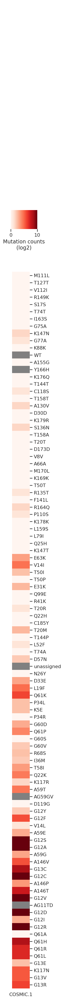

In [14]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+mutsig['COSMIC.1'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_COSMIC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_COSMIC.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


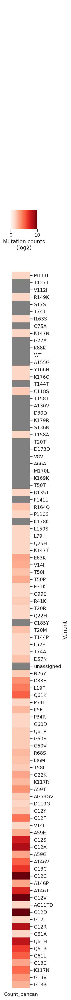

In [15]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+anno['Count_pancan'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.png',bbox_inches = "tight")

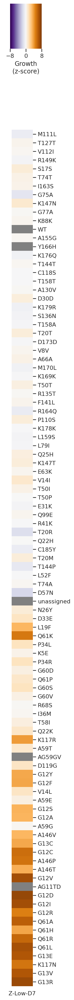

In [18]:
x=8

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(mutsig.loc[sorted_variants,'Z-Low-D7'],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


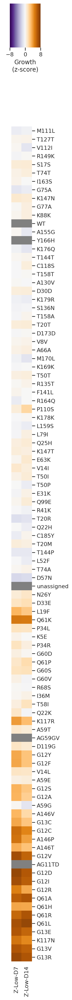

In [19]:
x=8

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(mutsig.loc[sorted_variants,['Z-Low-D7','Z-Low-D14']],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7D14.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7D14.png',bbox_inches = "tight")